## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 7.2%
RAM Usage: 16.3%
Available RAM: 1.2T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0


RuntimeError: Could not find an available GPU after 1 attempts with 900 seconds interval.

In [ ]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

### Model Parameter Counts

#### **Linear Models**
- **PCA Bilinear:** 730  _(27 PCs)_
- **PLS Bilinear:** 101  _(10 PLS components)_
- **Bilinear Low-rank:** 73,800  _(rank 10)_
- **PLS MLP:** 158,993  _(10 PLS components, including PLS projection matrices)_
- **PCA MLP:** 47,873  _(27 PCs, 2-layer)_

---

#### **MLP and SMT Models**

#### 2-Layer Models
- **MLP:** 3,812,609
- **SMT:** 1,399,947
- **MLP w/ CLS:** 3,814,145
- **SMT w/ CLS:** 1,405,579

#### 3-Layer Models
- **MLP:** 7,723,777
- **SMT:** 2,162,315
- **MLP w/ CLS:** 7,726,849
- **SMT w/ CLS:** 2,173,067

---

### Coord MLP Parameter Counts
- **[32]:** 321
- **[64, 32]:** 2,753
- **[128, 64]:** 9,601
- **[256, 128]:** 35,685
- **[512, 256, 128]:** 169,729


Number of regions per lobe:
Frontal: 132
Parietal: 121
Temporal: 95
Occipital: 52
Subcortex: 46
Cerebellum: 10


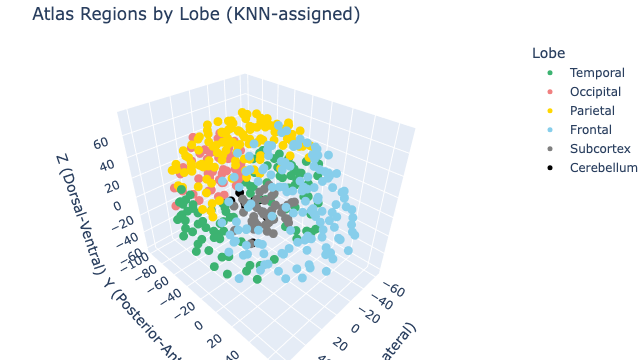

In [11]:
import pandas as pd
import plotly.express as px

# Load updated atlas
df = pd.read_csv("./data/UKBB/atlas-4S456Parcels_dseg_reformatted.csv")

# Fallback hover name if 'parcel_name' is missing
hover_col = "parcel_name" if "parcel_name" in df.columns else "label"
df["hover_label"] = df[hover_col]

# Set unknown lobes to "Unknown"
df["Lobe"] = df["lobe"].fillna("Unknown")

# Count number of regions per lobe
lobe_counts = df["Lobe"].value_counts()
print("\nNumber of regions per lobe:")
for lobe, count in lobe_counts.items():
    print(f"{lobe}: {count}")

# Plot
fig = px.scatter_3d(
    df,
    x="mni_x", y="mni_y", z="mni_z",
    color="Lobe",
    hover_name="hover_label",
    opacity=1,
    color_discrete_map={
        "Frontal": "skyblue",
        "Temporal": "mediumseagreen",
        "Parietal": "gold",
        "Occipital": "lightcoral",
        "Subcortex": "gray",
        "Cerebellum": "black"
    }
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(
    title="Atlas Regions by Lobe (KNN-assigned)",
    scene=dict(
        xaxis_title="X (Lateral)",
        yaxis_title="Y (Posterior-Anterior)",
        zaxis_title="Z (Dorsal-Ventral)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

In [ ]:
import pandas as pd
import plotly.express as px

# Load updated atlas
df = pd.read_csv("./data/UKBB/atlas_with_lobes_knn.csv")

# Fallback hover name if 'parcel_name' is missing
hover_col = "parcel_name" if "parcel_name" in df.columns else "label"
df["hover_label"] = df[hover_col]

# Set unknown lobes to "Unknown"
df["Lobe"] = df["lobe"].fillna("Unknown")


# Count number of regions per lobe
lobe_counts = df["Lobe"].value_counts()
print("\nNumber of regions per lobe:")
for lobe, count in lobe_counts.items():
    print(f"{lobe}: {count}")

# Plot
fig = px.scatter_3d(
    df,
    x="mni_x", y="mni_y", z="mni_z",
    color="Lobe",
    hover_name="hover_label",
    opacity=0.8,
    color_discrete_map={
        "Frontal": "skyblue",
        "Temporal": "mediumseagreen",
        "Parietal": "gold",
        "Occipital": "lightcoral",
        "Subcortex": "gray",
        "Cerebellum": "black"
    }
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(
    title="Atlas Regions by Lobe (KNN-assigned)",
    scene=dict(
        xaxis_title="X (Lateral)",
        yaxis_title="Y (Posterior-Anterior)",
        zaxis_title="Z (Dorsal-Ventral)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 95, 'Occipital': 52, 'Parietal': 121, 'Frontal': 132, 'Subcortex': 46, 'Cerebellum': 9}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset



distutils Version classes are deprecated. Use packaging.version instead.


ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 5bt5evsz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/5bt5evsz
Initialized sweep with ID: 5bt5evsz
Testing network: Subcortex
Temporal
Occipital
Parietal
Frontal
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in Bilinear low rank model: 73800
  Linear layer 1: 73800 parameters



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB
Best val loss so far at epoch 1: 0.0153
Epoch 5/125, Train Loss: 0.0238, Val Loss: 0.0470, Time: 2.65s
Epoch 10/125, Train Loss: 0.0202, Val Loss: 0.0367, Time: 2.98s
Epoch 15/125, Train Loss: 0.0196, Val Loss: 0.0443, Time: 3.12s
Epoch 20/125, Train Loss: 0.0177, Val Loss: 0.0764, Time: 2.94s
Epoch 25/125, Train Loss: 0.0966, Val Loss: 0.0675, Time: 2.62s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.078549
Epoch 30/125, Train Loss: 0.0123, Val Loss: 0.0799, Time: 2.52s
Epoch 35/125, Train Loss: 0.0122, Val Loss: 0.0900, Time: 2.60s
Epoch 40/125, Train Loss: 0.0118, Val Loss: 0.0899, Time: 2.62s

Early stopping triggered at epoch 41. Restoring best model with Val Loss: 0.0153, Pearson Correlation: 0.3262
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 409 regions, 166872 connections


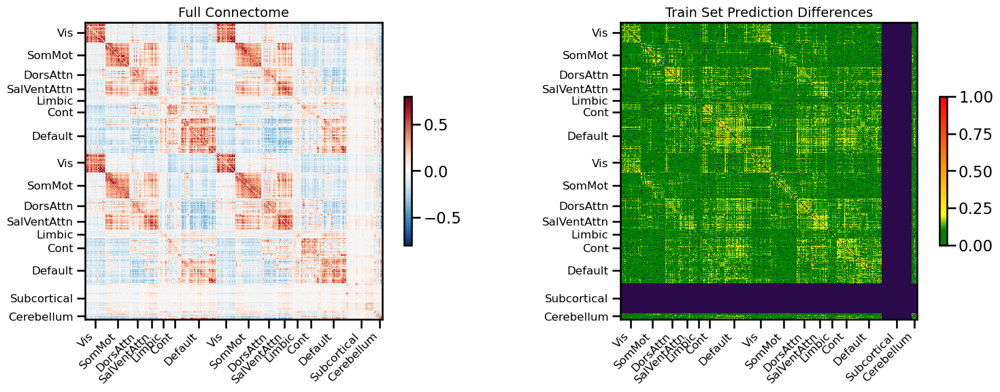

<Figure size 640x480 with 0 Axes>

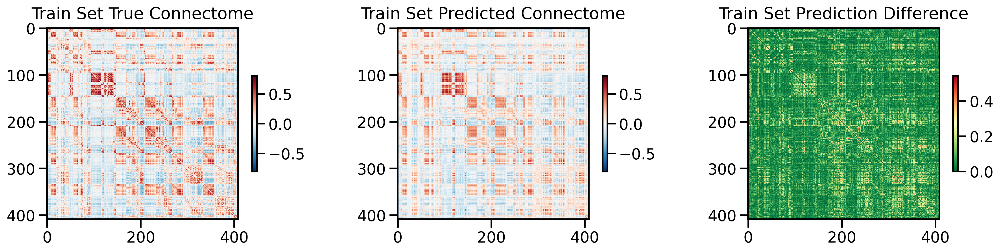

<Figure size 640x480 with 0 Axes>

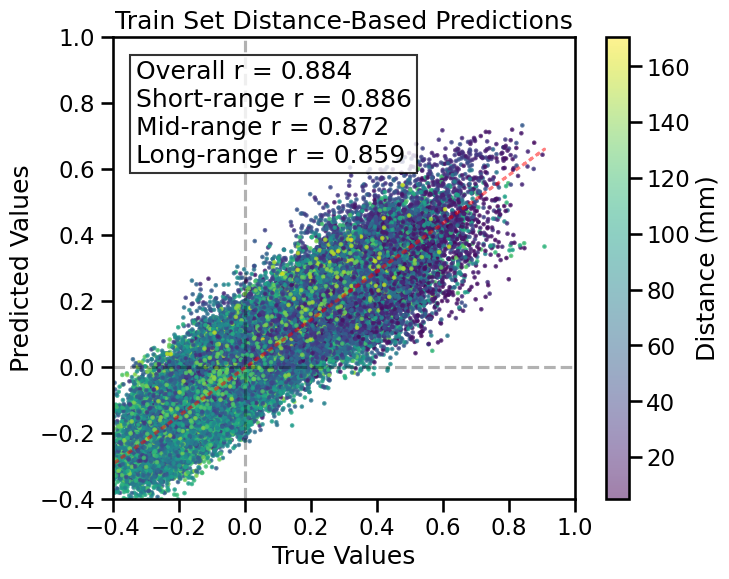

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 46 regions, 2070 connections


<Figure size 640x480 with 0 Axes>

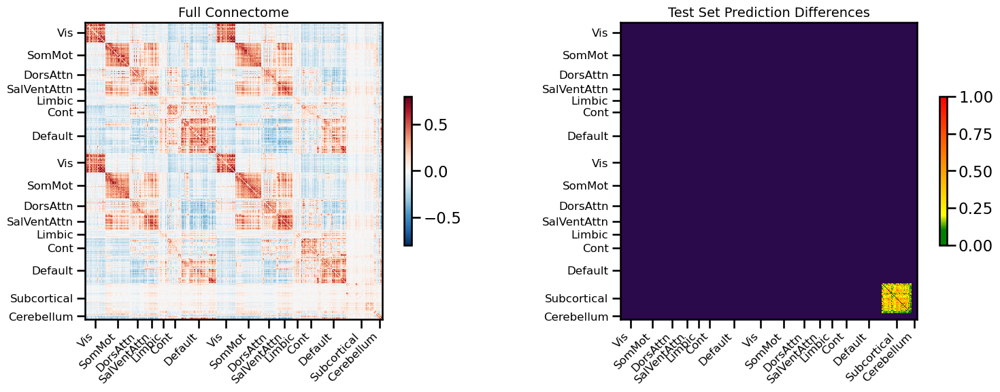

<Figure size 640x480 with 0 Axes>

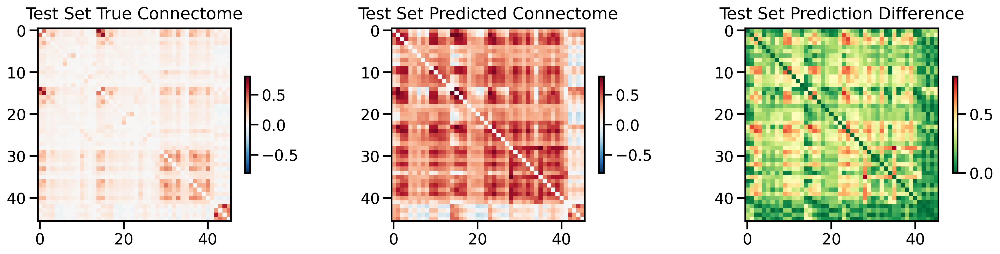

<Figure size 640x480 with 0 Axes>

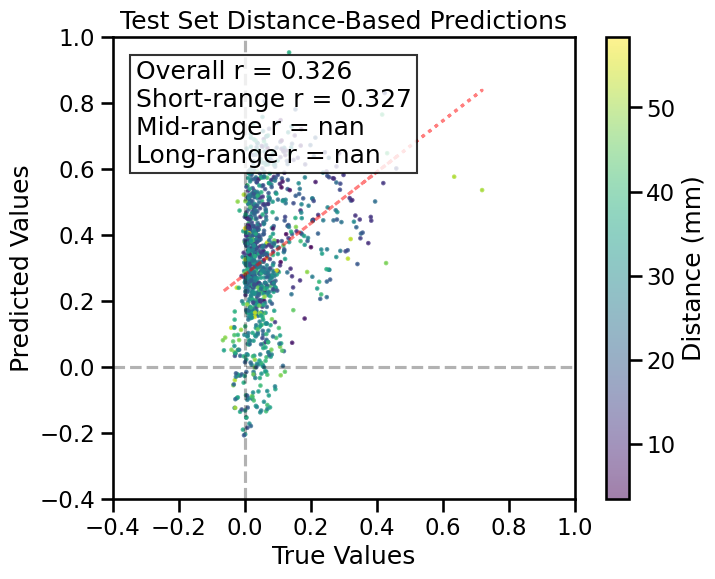

TRAIN METRICS
GLOBAL: mse=0.009015, mae=0.070281, r2=0.7766, pearson_r=0.8839, spearman_r=0.8765, geodesic_distance=20.3764
DISTANCE-BASED: short=0.8859, mid=0.8718, long=0.8594
HEMISPHERIC: left=0.8855, right=0.8914, inter=0.8852
CONNECTION STRENGTH: neg=0.2120, weak=0.8252, pos=0.5206
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9078    0.8860
  Default       0.8869    0.8832
  SalVentAttn    0.8413    0.8867
  Limbic        0.8997    0.9084
  DorsAttn      0.8998    0.8971
  SomMot        0.8596    0.8721
  Vis           0.8646    0.8789
  Cerebellum    0.8475    0.8903

TEST METRICS
GLOBAL: mse=0.106237, mae=0.282183, r2=-14.2832, pearson_r=0.3262, spearman_r=0.2935, geodesic_distance=13.1942
DISTANCE-BASED: short=0.3266
HEMISPHERIC: left=0.2942, right=0.3319, inter=0.3375
CONNECTION STRENGTH: weak=0.3076
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Subcortical    0.2896       N/


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,▁▂▂▄▄▂▂▂▂▃▃▂▃▃▃▄▃▃▄▆▇▃▅█▅▅▆▆▇▆▇▇▇▇▇▇▇███
train_mse_loss,▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.09809
train_mse_loss,0.01164


Final evaluation metrics logged successfully.
CPU Usage: 2.2%
RAM Usage: 19.3%
Available RAM: 1.2T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  2% |
Sim complete
Simulation completed in 163.55 seconds (2.73 minutes)


0

<Figure size 640x480 with 0 Axes>

In [13]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='bilinear_lowrank',
              use_gpu=True,
              null_model='none',
              use_folds=[4]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 91, 'Occipital': 52, 'Parietal': 125, 'Frontal': 132, 'Subcortex': 55}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: p23i2jyd
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/p23i2jyd
Initialized sweep with ID: p23i2jyd
Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: xmfpdo5t with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 125
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 1e-05
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 15
wandb: 	regularization: l2
wandb: 	shared_weights: True
ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-p23i2jyd/config-xmfpdo5t.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Processing inner fold 0



unclosed <socket.socket fd=79, family=2, type=1, proto=0, laddr=('127.0.0.1', 56974), raddr=('127.0.0.1', 42975)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 110700
  Linear layer 1: 110700 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0993
Best val loss so far at epoch 4: 0.0984
Epoch 5/125, Train Loss: 0.0239, Val Loss: 0.1127, Time: 3.12s
Best val loss so far at epoch 7: 0.0846
Epoch 10/125, Train Loss: 0.0192, Val Loss: 0.1118, Time: 3.70s
Epoch 15/125, Train Loss: 0.0188, Val Loss: 0.1022, Time: 3.33s
Epoch 20/125, Train Loss: 0.0180, Val Loss: 0.0926, Time: 3.36s
Epoch 25/125, Train Loss: 0.0166, Val Loss: 0.0957, Time: 2.97s
Best val loss so far at epoch 27: 0.0763
Epoch 30/125, Train Loss: 4.1554, Val Loss: 0.1063, Time: 3.10s
Epoch 35/125, Train Loss: 0.0130, Val Loss: 0.1083, Time: 3.13s
Epoch 40/125, Train Loss: 0.0128, Val Loss: 0.1065, Time: 3.13s
Epoch 45/125, Train Loss: 0.0126, Val Loss: 0.1102, Time: 3.20s
Epoch 50/125, Train Loss: 0.0123, Val Loss: 0.1053, Time: 3.22s

LR REDUCED: 0.000100 

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▇▆▆▅▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
fold0_val_loss,▃▇▃▆▆█▆▆▅▇▄▂▇▄▆▆▅▅▅▆▆▅▅▅▆▄▆▆▅▅▅▄▅▄▅▁▄▂▄▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,66
fold0_train_loss,0.01
fold0_val_loss,0.09974


wandb: Agent Starting Run: urads83x with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 100
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0.001
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 5
wandb: 	regularization: l2
wandb: 	shared_weights: True
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-p23i2jyd/config-urads83x.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





unclosed <socket.socket fd=108, family=2, type=1, proto=0, laddr=('127.0.0.1', 48654), raddr=('127.0.0.1', 34231)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 36900
  Linear layer 1: 36900 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.1364
Best val loss so far at epoch 2: 0.1028
Epoch 5/100, Train Loss: 0.0243, Val Loss: 0.1085, Time: 3.09s
Best val loss so far at epoch 10: 0.1012
Epoch 10/100, Train Loss: 0.0187, Val Loss: 0.1012, Time: 3.77s
Best val loss so far at epoch 11: 0.0951
Epoch 15/100, Train Loss: 0.0150, Val Loss: 0.1068, Time: 3.38s
Epoch 20/100, Train Loss: 0.0123, Val Loss: 0.1339, Time: 3.14s
Best val loss so far at epoch 21: 0.0668
Epoch 25/100, Train Loss: 0.0112, Val Loss: 0.0995, Time: 3.22s
Epoch 30/100, Train Loss: 0.0103, Val Loss: 0.0902, Time: 3.27s
Epoch 35/100, Train Loss: 0.0098, Val Loss: 0.1207, Time: 3.09s
Epoch 40/100, Train Loss: 0.0094, Val Loss: 0.1190, Time: 3.26s
Epoch 45/100, Train Loss: 0.0090, Val Loss: 0.0937, Time: 3.31s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇███
fold0_train_loss,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▆▅█▅▅▆▆▆▇▆▇█▁▆▄▆▄▅▅▂▃▆▂▅▅▆▂▆▄▂▄▅▅▄▃▅▂▅
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,60
fold0_train_loss,0.00798
fold0_val_loss,0.10186


wandb: Agent Starting Run: 3tgknu6o with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 100
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 1e-05
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 8
wandb: 	regularization: l2
wandb: 	shared_weights: True
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-p23i2jyd/config-3tgknu6o.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





unclosed <socket.socket fd=80, family=2, type=1, proto=0, laddr=('127.0.0.1', 52168), raddr=('127.0.0.1', 42315)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 59040
  Linear layer 1: 59040 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.1433
Best val loss so far at epoch 3: 0.1307
Best val loss so far at epoch 5: 0.1179
Epoch 5/100, Train Loss: 0.0235, Val Loss: 0.1179, Time: 3.49s
Best val loss so far at epoch 6: 0.1016
Best val loss so far at epoch 8: 0.0845
Best val loss so far at epoch 10: 0.0799
Epoch 10/100, Train Loss: 0.0170, Val Loss: 0.0799, Time: 3.93s
Epoch 15/100, Train Loss: 0.0141, Val Loss: 0.1107, Time: 3.34s
Epoch 20/100, Train Loss: 0.0138, Val Loss: 0.1120, Time: 3.52s
Epoch 25/100, Train Loss: 0.0132, Val Loss: 0.1025, Time: 3.45s
Epoch 30/100, Train Loss: 0.0123, Val Loss: 0.0883, Time: 3.29s
Epoch 35/100, Train Loss: 0.0106, Val Loss: 0.0923, Time: 3.53s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.089489
Epoch 40/100, Train Loss: 0.0089, Val Loss: 0.0927, Time: 3.49s
Best val loss so 

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,██▅▂▄▅▅▅▅▄▅▄▅▅▃▄▃▄▄▃▃▂▂▂▁▂▂▂▃▁▂▃▁▃▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,99
fold0_train_loss,0.00494
fold0_val_loss,0.07642


wandb: Agent Starting Run: 0vuu9p56 with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 100
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0.001
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 20
wandb: 	regularization: l2
wandb: 	shared_weights: True
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-p23i2jyd/config-0vuu9p56.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Processing inner fold 0



unclosed <socket.socket fd=108, family=2, type=1, proto=0, laddr=('127.0.0.1', 35322), raddr=('127.0.0.1', 34119)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 147600
  Linear layer 1: 147600 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.1472
Best val loss so far at epoch 2: 0.1337
Best val loss so far at epoch 4: 0.1210
Epoch 5/100, Train Loss: 0.0284, Val Loss: 0.1566, Time: 2.71s
Best val loss so far at epoch 9: 0.1178
Best val loss so far at epoch 10: 0.0730
Epoch 10/100, Train Loss: 0.0226, Val Loss: 0.0730, Time: 3.15s
Epoch 15/100, Train Loss: 0.0178, Val Loss: 0.1134, Time: 2.71s
Epoch 20/100, Train Loss: 0.0171, Val Loss: 0.1105, Time: 2.69s
Epoch 25/100, Train Loss: 0.0168, Val Loss: 0.1101, Time: 2.56s
Epoch 30/100, Train Loss: 0.0167, Val Loss: 0.1125, Time: 2.79s
Epoch 35/100, Train Loss: 0.0164, Val Loss: 0.1111, Time: 2.65s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.110101
Epoch 40/100, Train Loss: 0.0161, Val Loss: 0.1103, Time: 2.60s
Epoch 45/100, Train Loss: 0.0156, Val Loss: 0.1079, Tim

fold0_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▇▆▇▅█▇▆▅▁▄▁▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,49
fold0_train_loss,0.01488
fold0_val_loss,0.0859


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 14760, 'activation': 'none', 'batch_size': 256, 'lambda_reg': 1e-05, 'reduced_dim': 8, 'learning_rate': 0.0001, 'regularization': 'l2', 'shared_weights': True}
Number of learnable parameters in Bilinear low rank model: 59040
  Linear layer 1: 59040 parameters



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0362
Best val loss so far at epoch 2: 0.0319
Best val loss so far at epoch 3: 0.0307
Best val loss so far at epoch 4: 0.0275
Best val loss so far at epoch 5: 0.0258
Epoch 5/100, Train Loss: 0.0210, Val Loss: 0.0258, Time: 4.39s
Best val loss so far at epoch 6: 0.0249



unclosed <socket.socket fd=80, family=2, type=1, proto=0, laddr=('127.0.0.1', 42660), raddr=('127.0.0.1', 33293)>




Epoch 10/100, Train Loss: 0.0136, Val Loss: 0.0262, Time: 4.70s
Epoch 15/100, Train Loss: 0.0131, Val Loss: 0.0275, Time: 4.79s
Epoch 20/100, Train Loss: 0.0119, Val Loss: 0.0283, Time: 4.93s
Epoch 25/100, Train Loss: 0.0102, Val Loss: 0.0368, Time: 4.86s
Epoch 30/100, Train Loss: 0.0083, Val Loss: 0.0301, Time: 4.77s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.031007
Epoch 35/100, Train Loss: 0.0067, Val Loss: 0.0285, Time: 4.89s
Epoch 40/100, Train Loss: 0.0064, Val Loss: 0.0282, Time: 5.16s
Epoch 45/100, Train Loss: 0.0059, Val Loss: 0.0288, Time: 4.85s

Early stopping triggered at epoch 46. Restoring best model with Val Loss: 0.0249, Pearson Correlation: 0.5216
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 364 regions, 132132 connections


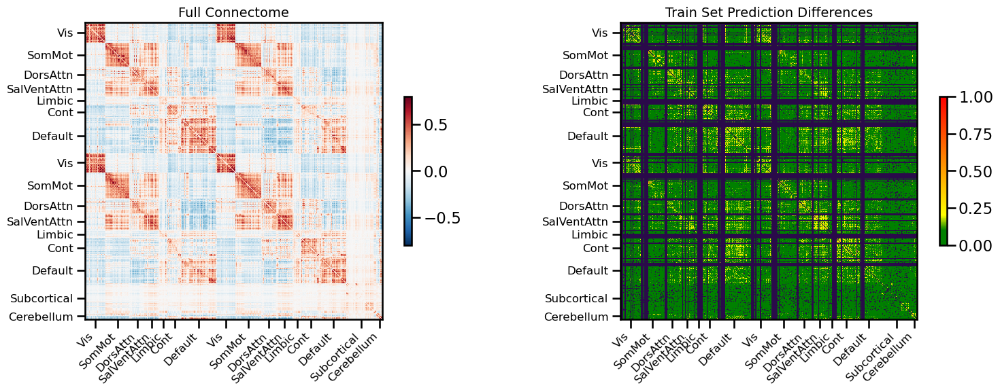

<Figure size 640x480 with 0 Axes>

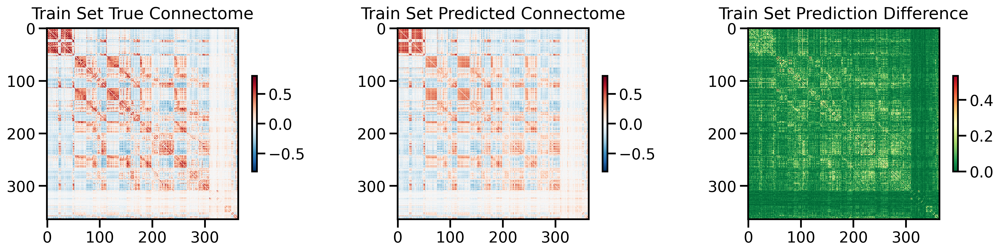

<Figure size 640x480 with 0 Axes>

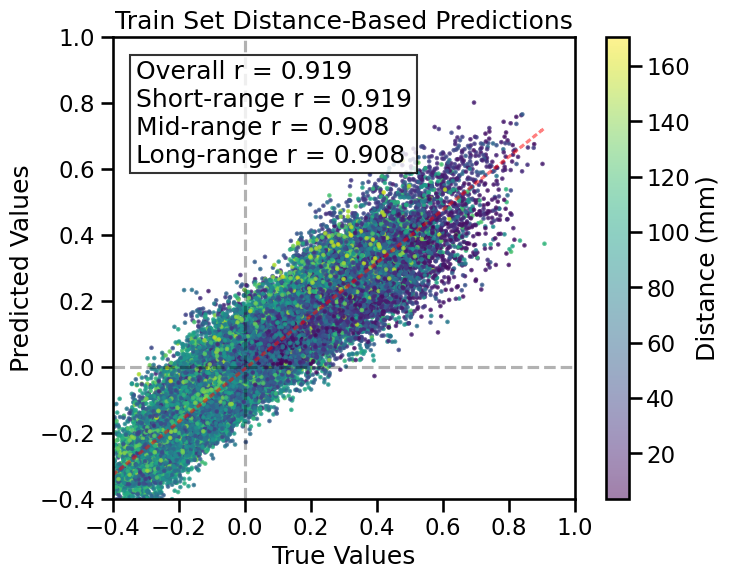

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 91 regions, 8190 connections


<Figure size 640x480 with 0 Axes>

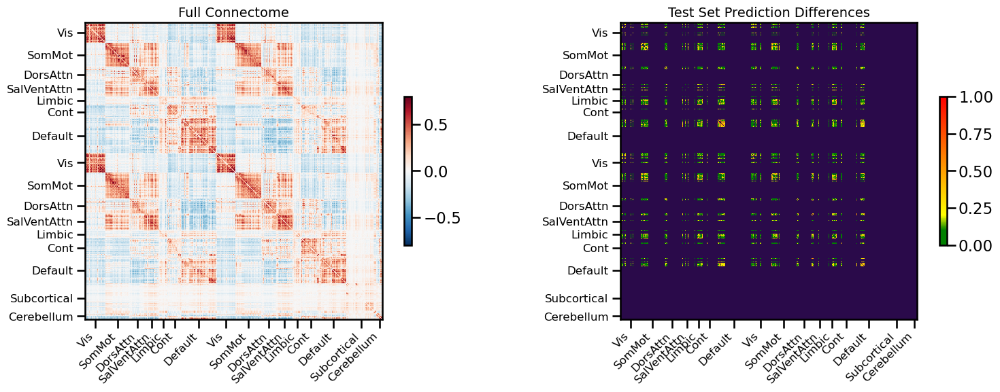

<Figure size 640x480 with 0 Axes>

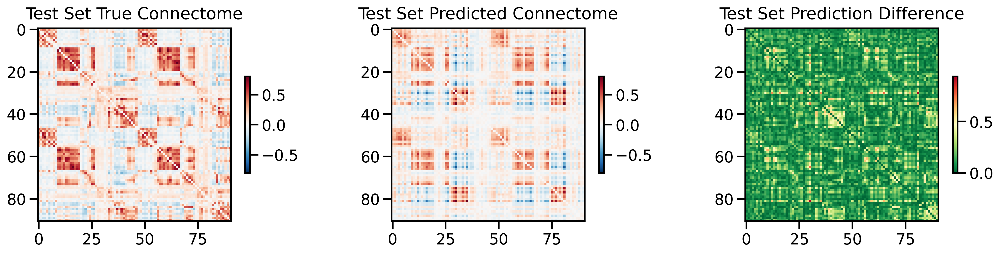

<Figure size 640x480 with 0 Axes>

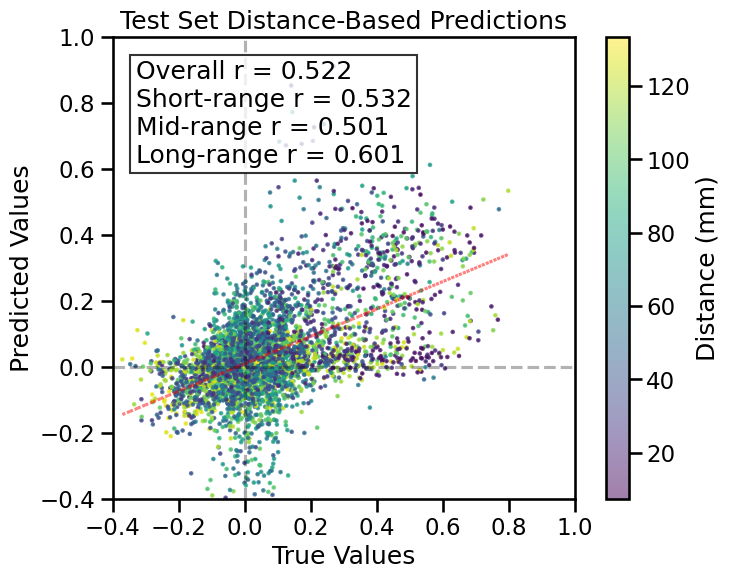

TRAIN METRICS
GLOBAL: mse=0.005763, mae=0.053219, r2=0.8402, pearson_r=0.9187, spearman_r=0.9140, geodesic_distance=18.3300
DISTANCE-BASED: short=0.9186, mid=0.9083, long=0.9076
HEMISPHERIC: left=0.9243, right=0.9269, inter=0.9177
CONNECTION STRENGTH: neg=0.3112, weak=0.8771, pos=0.5836
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9214    0.9267
  Default       0.9384    0.9262
  SalVentAttn    0.9291    0.9276
  Limbic        0.8549    0.9184
  DorsAttn      0.9338    0.9367
  SomMot        0.9250    0.9366
  Vis           0.9600    0.9336
  Subcortical    0.8957    0.9222
  Cerebellum    0.9109    0.9157

TEST METRICS
GLOBAL: mse=0.029002, mae=0.127238, r2=0.1617, pearson_r=0.5216, spearman_r=0.4806, geodesic_distance=15.6335
DISTANCE-BASED: short=0.5316, mid=0.5008, long=0.6013
HEMISPHERIC: left=0.5099, right=0.4975, inter=0.5419
CONNECTION STRENGTH: weak=0.3377, pos=0.2368
NETWORK CORRELATIONS:
  NETWORK      INTRA      IN


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,█▅▄▃▂▁▃▂▂▂▂▂▂▃▃▃▃▃▅▃▅█▃▅▃▃▄▃▄▄▃▃▄▃▃▄▃▃▄▃
train_mse_loss,▄▃▃▃▂▂▂█▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.07642
test_mse_loss,0.02903
train_mse_loss,0.00596


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: f64nue7d
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/f64nue7d
Initialized sweep with ID: f64nue7d
Testing network: Occipital
Temporal
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: rh71bcgq with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 150
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 1e-05
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 8
wandb: 	regularization: l2
wandb: 	shared_weights: True
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-f64nue7d/config-rh71bcgq.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 59040
  Linear layer 1: 59040 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0343
Best val loss so far at epoch 2: 0.0324
Best val loss so far at epoch 3: 0.0285
Epoch 5/150, Train Loss: 0.0242, Val Loss: 0.0292, Time: 3.30s
Best val loss so far at epoch 8: 0.0262
Epoch 10/150, Train Loss: 0.3016, Val Loss: 0.0264, Time: 3.35s
Best val loss so far at epoch 11: 0.0260
Best val loss so far at epoch 12: 0.0259
Best val loss so far at epoch 13: 0.0257
Best val loss so far at epoch 15: 0.0257
Epoch 15/150, Train Loss: 0.0163, Val Loss: 0.0257, Time: 3.27s
Best val loss so far at epoch 16: 0.0255
Epoch 20/150, Train Loss: 0.0159, Val Loss: 0.0262, Time: 2.91s
Epoch 25/150, Train Loss: 0.0150, Val Loss: 0.0264, Time: 3.33s
Epoch 5/100, Train Loss: 0.0275, Val Loss: 0.0338, Time: 2.73s
Best val loss so far at epoch 10: 0.0294
Epoch 10/100, Train Loss: 0.0215, Va

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,▄▃▃▂▂▂▂▂▂▂▂▂▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▁▁▁▁▁▁▁▁▁▁▁▁▂█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,49
fold0_train_loss,0.01008
fold0_val_loss,0.03173


wandb: Agent Starting Run: 7aixbhkf with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 150
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0.001
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 10
wandb: 	regularization: l2
wandb: 	shared_weights: True
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-f64nue7d/config-7aixbhkf.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Processing inner fold 0



unclosed <socket.socket fd=110, family=2, type=1, proto=0, laddr=('127.0.0.1', 38808), raddr=('127.0.0.1', 35017)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 73800
  Linear layer 1: 73800 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0380
Best val loss so far at epoch 2: 0.0345
Best val loss so far at epoch 3: 0.0329
Best val loss so far at epoch 4: 0.0299
Epoch 5/150, Train Loss: 0.0261, Val Loss: 0.0300, Time: 3.09s
Best val loss so far at epoch 6: 0.0299
Best val loss so far at epoch 7: 0.0289
Epoch 10/150, Train Loss: 0.0212, Val Loss: 0.0296, Time: 2.65s
Epoch 15/150, Train Loss: 0.0166, Val Loss: 0.0298, Time: 2.64s
Epoch 20/150, Train Loss: 0.0165, Val Loss: 0.0294, Time: 2.48s
Epoch 25/150, Train Loss: 0.0161, Val Loss: 0.0300, Time: 2.65s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.031780
Epoch 30/150, Train Loss: 0.0156, Val Loss: 0.0318, Time: 2.63s
Epoch 35/150, Train Loss: 0.0149, Val Loss: 0.0300, Time: 2.71s
Epoch 40/150, Train Loss: 0.0141, Val Loss: 0.0312, Time: 2.59s
Epoch 45/150, Trai

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▃▂▁▁▁█▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▂▂▂▂▂▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,46
fold0_train_loss,0.01256
fold0_val_loss,0.0357


wandb: Agent Starting Run: xk7xheqy with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 100
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0.001
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 12
wandb: 	regularization: l2
wandb: 	shared_weights: True
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-f64nue7d/config-xk7xheqy.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





unclosed <socket.socket fd=106, family=2, type=1, proto=0, laddr=('127.0.0.1', 41722), raddr=('127.0.0.1', 38473)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 88560
  Linear layer 1: 88560 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0369
Best val loss so far at epoch 2: 0.0359
Best val loss so far at epoch 3: 0.0310
Best val loss so far at epoch 4: 0.0296
Epoch 5/100, Train Loss: 0.0269, Val Loss: 0.0331, Time: 2.84s
Best val loss so far at epoch 9: 0.0292
Epoch 10/100, Train Loss: 0.0210, Val Loss: 0.0366, Time: 2.97s
Best val loss so far at epoch 12: 0.0292
Epoch 15/100, Train Loss: 0.0178, Val Loss: 0.0293, Time: 2.91s
Epoch 20/100, Train Loss: 0.0177, Val Loss: 0.0296, Time: 2.97s
Epoch 25/100, Train Loss: 0.0175, Val Loss: 0.0295, Time: 2.99s
Epoch 30/100, Train Loss: 0.0170, Val Loss: 0.0301, Time: 2.98s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.029671
Epoch 35/100, Train Loss: 0.0158, Val Loss: 0.0297, Time: 3.07s
Epoch 40/100, Train Loss: 0.0147, Val Loss: 0.0311, Time: 3.00s
Epoch 45/100, Tra

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▇▃▅▆▇▁█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▃▃▂▃▃▄▃▄▄▅▅▅▅▅▆
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,51
fold0_train_loss,0.01184
fold0_val_loss,0.03468


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 150, 'binarize': False, 'input_dim': 14760, 'activation': 'none', 'batch_size': 256, 'lambda_reg': 1e-05, 'reduced_dim': 8, 'learning_rate': 0.0001, 'regularization': 'l2', 'shared_weights': True}
Number of learnable parameters in Bilinear low rank model: 59040
  Linear layer 1: 59040 parameters



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.1247
Best val loss so far at epoch 4: 0.0913
Best val loss so far at epoch 5: 0.0841
Epoch 5/150, Train Loss: 0.0193, Val Loss: 0.0841, Time: 5.15s



unclosed <socket.socket fd=108, family=2, type=1, proto=0, laddr=('127.0.0.1', 35826), raddr=('127.0.0.1', 40041)>



unclosed <socket.socket fd=109, family=2, type=1, proto=0, laddr=('127.0.0.1', 45906), raddr=('127.0.0.1', 44135)>




Epoch 10/150, Train Loss: 0.0167, Val Loss: 0.0854, Time: 5.66s
Best val loss so far at epoch 12: 0.0822
Best val loss so far at epoch 13: 0.0817
Best val loss so far at epoch 14: 0.0686
Best val loss so far at epoch 15: 0.0661
Epoch 15/150, Train Loss: 0.0151, Val Loss: 0.0661, Time: 5.30s
Best val loss so far at epoch 16: 0.0599
Best val loss so far at epoch 18: 0.0531
Epoch 20/150, Train Loss: 0.0118, Val Loss: 0.0549, Time: 5.29s
Best val loss so far at epoch 21: 0.0527
Best val loss so far at epoch 25: 0.0515
Epoch 25/150, Train Loss: 0.0091, Val Loss: 0.0515, Time: 5.03s
Best val loss so far at epoch 28: 0.0511
Best val loss so far at epoch 29: 0.0500
Epoch 30/150, Train Loss: 0.0090, Val Loss: 0.0502, Time: 5.39s
Best val loss so far at epoch 31: 0.0492
Best val loss so far at epoch 35: 0.0480
Epoch 35/150, Train Loss: 0.0087, Val Loss: 0.0480, Time: 5.26s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.064867
Epoch 55/150, Train Loss: 0.0069, Val Loss: 0.0649, Time: 5.33s
Best 

<Figure size 640x480 with 0 Axes>

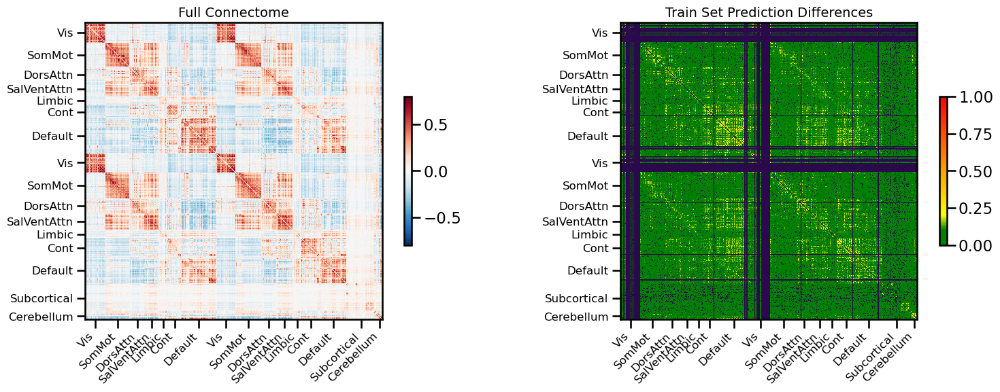

<Figure size 640x480 with 0 Axes>

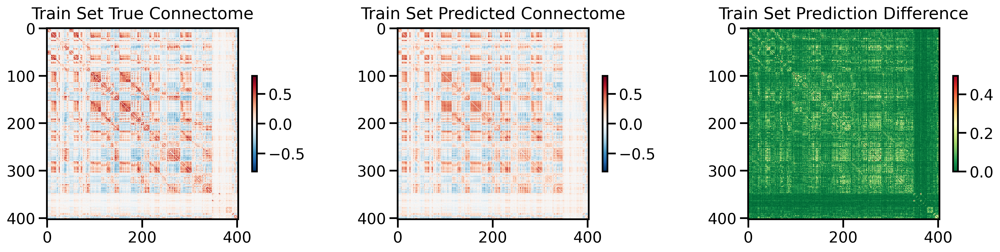

<Figure size 640x480 with 0 Axes>

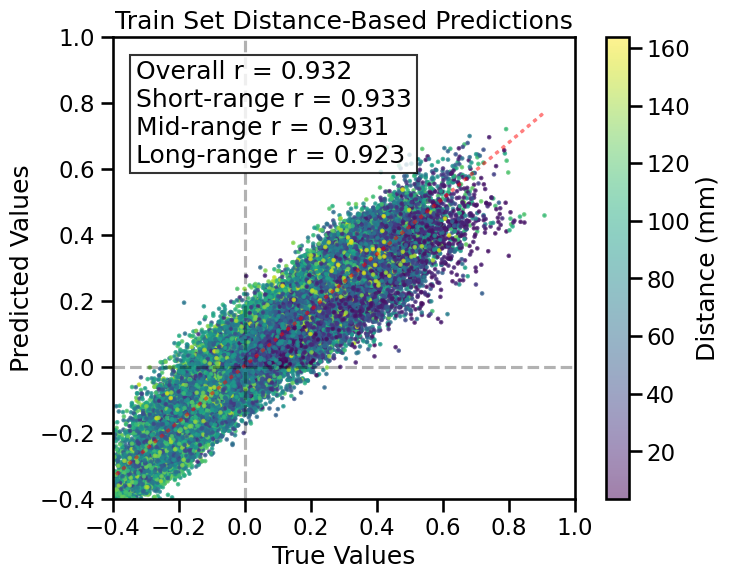

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 52 regions, 2652 connections


<Figure size 640x480 with 0 Axes>

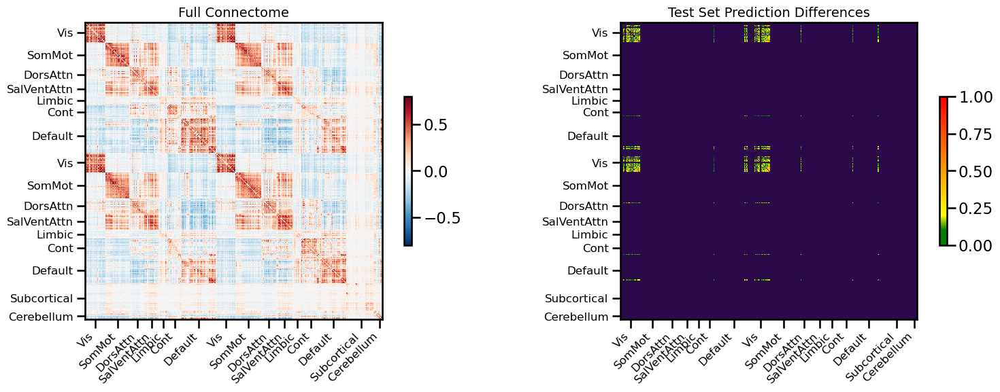

<Figure size 640x480 with 0 Axes>

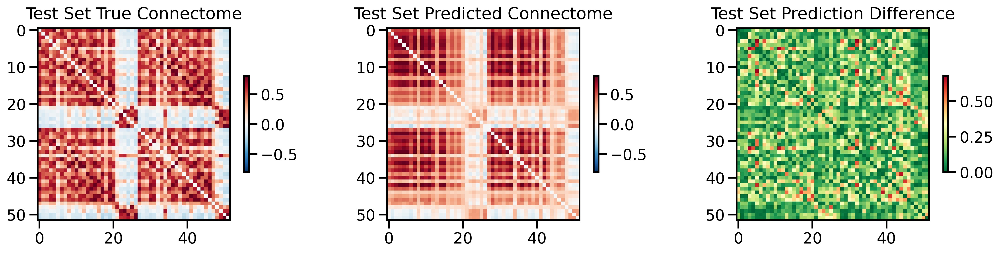

<Figure size 640x480 with 0 Axes>

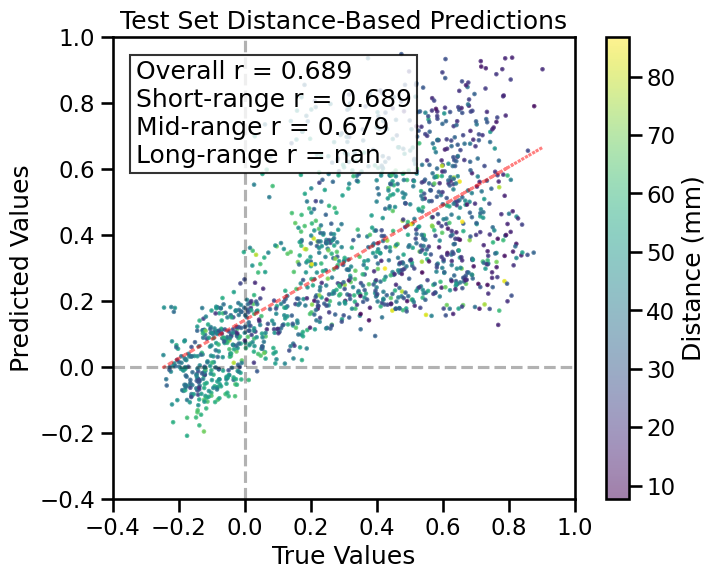

TRAIN METRICS
GLOBAL: mse=0.004306, mae=0.046103, r2=0.8682, pearson_r=0.9321, spearman_r=0.9298, geodesic_distance=19.3148
DISTANCE-BASED: short=0.9329, mid=0.9311, long=0.9232
HEMISPHERIC: left=0.9344, right=0.9385, inter=0.9358
CONNECTION STRENGTH: neg=0.3304, weak=0.9054, pos=0.5233
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9356    0.9399
  Default       0.9431    0.9385
  SalVentAttn    0.9621    0.9475
  Limbic        0.9517    0.9444
  DorsAttn      0.9288    0.9308
  SomMot        0.8839    0.9201
  Vis           0.9054    0.9373
  Subcortical    0.9546    0.9381
  Cerebellum    0.8128    0.9382

TEST METRICS
GLOBAL: mse=0.048044, mae=0.173157, r2=0.4492, pearson_r=0.6887, spearman_r=0.7124, geodesic_distance=6.8005
DISTANCE-BASED: short=0.6891, mid=0.6787
HEMISPHERIC: left=0.7195, right=0.6644, inter=0.6854
CONNECTION STRENGTH: weak=0.7079, pos=0.1618
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  --------


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,▄▃▄▃▂▁▁▁▄▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,▂▂▂▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02901
test_mse_loss,0.04899
train_mse_loss,0.00448


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: a2ajyf29
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/a2ajyf29
Initialized sweep with ID: a2ajyf29
Testing network: Parietal
Temporal
Occipital
Frontal
Subcortex


wandb: Agent Starting Run: 7vd6bknd with config:
wandb: 	activation: none
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	epochs: 150
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0.001
wandb: 	learning_rate: 0.0001
wandb: 	reduced_dim: 12
wandb: 	regularization: l2
wandb: 	shared_weights: True
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-a2ajyf29/config-7vd6bknd.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb.init() arg project when running a sweep.

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in Bilinear low rank model: 88560
  Linear layer 1: 88560 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0371
Best val loss so far at epoch 2: 0.0364
Epoch 5/150, Train Loss: 0.0257, Val Loss: 0.0365, Time: 1.58s
Best val loss so far at epoch 6: 0.0358
Best val loss so far at epoch 8: 0.0355
Best val loss so far at epoch 10: 0.0351
Epoch 10/150, Train Loss: 0.0203, Val Loss: 0.0351, Time: 1.65s
Best val loss so far at epoch 11: 0.0332
Best val loss so far at epoch 13: 0.0325
Best val loss so far at epoch 14: 0.0314
Epoch 15/150, Train Loss: 0.0159, Val Loss: 0.0324, Time: 2.39s
Best val loss so far at epoch 19: 0.0312
Epoch 20/150, Train Loss: 0.0130, Val Loss: 0.0330, Time: 1.97s
Epoch 25/150, Train Loss: 0.0117, Val Loss: 0.0451, Time: 1.96s
Epoch 30/150, Train Loss: 2.6263, Val Loss: 140.7395, Time: 2.03s
Epoch 35/150, Train Loss: 0.0093, Val Loss: 0.0336, Time: 2.02s

LR REDUCE

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=False,
              model_type='bilinear_lowrank',
              use_gpu=True, 
              null_model='none',
              use_folds=[0, 1, 2, 3, 4]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 91, 'Occipital': 52, 'Parietal': 125, 'Frontal': 132, 'Subcortex': 55}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 4898j3n5
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/4898j3n5
Initialized sweep with ID: 4898j3n5
Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: lxn09kv2 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 100
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15808257
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.1254
Best val loss so far at epoch 2: 0.1009
Epoch 5/100, Train Loss: 0.0285, Val Loss: 0.1087, Time: 2.75s
Best val loss so far at epoch 8: 0.0928
Epoch 10/100, Train Loss: 0.0125, Val Loss: 0.1227, Time: 2.83s
Best val loss so far at epoch 15: 0.0829
Epoch 15/100, Train Loss: 0.0071, Val Loss: 0.0829, Time: 2.75s
Epoch 20/100, Train Loss: 0.0055, Val Loss: 0.1322, Time: 2.76s
Best val loss so far at epoch 22: 0.0797
Best val loss so far at epoch 25: 0.0793
Epoch 25/100, Train Loss: 0.0046, Val Loss: 0.0793, Time: 2.72s
Best val loss so far at epoch 28: 0.0681
Epoch 30/100, Train Loss: 0.0042, Val Loss: 0.0819, Time: 2.78s
Best val loss so far at epoch 31: 0.0610
Epoch 35/100, Train Loss: 0.0037, Val Loss: 0.0888, Time: 3.06s
Epoch 40/100, Train Loss: 0.0034, Val Loss: 0.0705, Time: 3.09s
Epoch 45/100, Train Loss: 0.0029, Val Lo

  from IPython.core.display import HTML, display  # type: ignore



fold0_epoch,▁▁▁▁▁▂▂▂▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇████
fold0_train_loss,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▅▆▄█▆▇▆▃▇▅▇▄▁▄▃▂▃▂▃▄▅▂▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,80
fold0_train_loss,0.00138
fold0_val_loss,0.06291


wandb: Agent Starting Run: 7n4hd01d with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.1115
Best val loss so far at epoch 4: 0.1070
Epoch 5/75, Train Loss: 0.0103, Val Loss: 0.1843, Time: 2.51s
Best val loss so far at epoch 8: 0.1021
Best val loss so far at epoch 9: 0.0926
Epoch 10/75, Train Loss: 0.0063, Val Loss: 0.1473, Time: 2.42s
Best val loss so far at epoch 13: 0.0894
Epoch 15/75, Train Loss: 0.0051, Val Loss: 0.1181, Time: 2.67s
Best val loss so far at epoch 17: 0.0785
Epoch 20/75, Train Loss: 0.0043, Val Loss: 0.1271, Time: 2.52s
Best val loss so far at epoch 21: 0.0775
Epoch 25/75, Train Loss: 0.0039, Val Loss: 0.0865, Time: 2.67s
Best val loss so far at epoch 28: 0.0703
Epoch 30/75, Train Loss: 0.0036, Val Loss: 0.1046, Time: 2.49s
Best val loss so far at epoch 34: 0.0678
Epoch 35/75, Train Loss: 0.0033, Val Loss: 0.1057, Time: 2.71s
Best val loss so far at epoch 39: 0.0658
Epoch 40/75, Train Loss: 0.0030

fold0_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇██
fold0_train_loss,█▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▄█▄▃▂▃▄▂▂▅▂▃▃▂▂▁▃▃▂▁▂▃▂▃▂▃▂▂▁▂▁▁▁▂▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.00145
fold0_val_loss,0.07183


wandb: Agent Starting Run: 803cj7v8 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 125
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15808257
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0898
Best val loss so far at epoch 5: 0.0793
Epoch 5/125, Train Loss: 0.0075, Val Loss: 0.0793, Time: 2.67s
Epoch 10/125, Train Loss: 0.0047, Val Loss: 0.0992, Time: 2.67s
Epoch 15/125, Train Loss: 0.0038, Val Loss: 0.0984, Time: 2.79s
Best val loss so far at epoch 17: 0.0761
Epoch 20/125, Train Loss: 0.0031, Val Loss: 0.0826, Time: 2.79s
Best val loss so far at epoch 24: 0.0754
Best val loss so far at epoch 25: 0.0660
Epoch 25/125, Train Loss: 0.0027, Val Loss: 0.0660, Time: 2.69s
Best val loss so far at epoch 27: 0.0611
Epoch 30/125, Train Loss: 0.0024, Val Loss: 0.0830, Time: 2.78s
Epoch 35/125, Train Loss: 0.0021, Val Loss: 0.0680, Time: 2.71s
Epoch 40/125, Train Loss: 0.0018, Val Loss: 0.0688, Time: 3.07s
Epoch 45/125, Train Loss: 0.0016, Val Loss: 0.0816, Time: 2.79s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.085634
Ep

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▇▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▆▇▄▆▄▄█▅▇▂▅▃▁▃▄▃▂▃▁▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,76
fold0_train_loss,0.00061
fold0_val_loss,0.07216


wandb: Agent Starting Run: rvk06xqz with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.1462
Best val loss so far at epoch 2: 0.1128
Best val loss so far at epoch 5: 0.1068
Epoch 5/100, Train Loss: 0.0081, Val Loss: 0.1068, Time: 2.55s
Best val loss so far at epoch 7: 0.1062
Best val loss so far at epoch 8: 0.0982
Best val loss so far at epoch 10: 0.0850
Epoch 10/100, Train Loss: 0.0053, Val Loss: 0.0850, Time: 2.60s
Epoch 15/100, Train Loss: 0.0041, Val Loss: 0.1371, Time: 2.58s
Epoch 20/100, Train Loss: 0.0036, Val Loss: 0.0923, Time: 2.58s
Best val loss so far at epoch 21: 0.0805
Best val loss so far at epoch 24: 0.0779
Best val loss so far at epoch 25: 0.0704
Epoch 25/100, Train Loss: 0.0031, Val Loss: 0.0704, Time: 2.65s
Best val loss so far at epoch 26: 0.0687
Epoch 30/100, Train Loss: 0.0029, Val Loss: 0.0698, Time: 2.63s
Epoch 35/100, Train Loss: 0.0026, Val Loss: 0.0852, Time: 2.62s
Epoch 40/100, Train Loss:

fold0_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▄▅▅▄▅▇▄▁▃▂▁▂▂▂▂▂▃▄▃▁▂▁▂▁▂▂▂▁▂▂▂▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,75
fold0_train_loss,0.00085
fold0_val_loss,0.07676


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 14760, 'batch_size': 512, 'hidden_dims': [1024, 512, 256, 128], 'dropout_rate': 0.1, 'weight_decay': 1e-05, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 15808257


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0421
Best val loss so far at epoch 2: 0.0291


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/100, Train Loss: 0.0213, Val Loss: 0.0342, Time: 4.12s
Best val loss so far at epoch 8: 0.0253
Best val loss so far at epoch 10: 0.0205
Epoch 10/100, Train Loss: 0.0083, Val Loss: 0.0205, Time: 4.47s
Best val loss so far at epoch 13: 0.0189
Epoch 15/100, Train Loss: 0.0053, Val Loss: 0.0266, Time: 4.50s
Epoch 20/100, Train Loss: 0.0043, Val Loss: 0.0333, Time: 4.35s
Epoch 25/100, Train Loss: 0.0037, Val Loss: 0.0271, Time: 4.22s
Epoch 30/100, Train Loss: 0.0034, Val Loss: 0.0217, Time: 4.47s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.023780
Epoch 35/100, Train Loss: 0.0025, Val Loss: 0.0218, Time: 4.29s
Epoch 40/100, Train Loss: 0.0022, Val Loss: 0.0223, Time: 4.52s
Epoch 45/100, Train Loss: 0.0020, Val Loss: 0.0251, Time: 4.27s
Epoch 50/100, Train Loss: 0.0019, Val Loss: 0.0254, Time: 4.31s
Epoch 55/100, Train Loss: 0.0018, Val Loss: 0.0228, Time: 4.68s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.023155
Epoch 60/100, Train Loss: 0.0016, Val Loss: 0.0236, Time: 4.35s



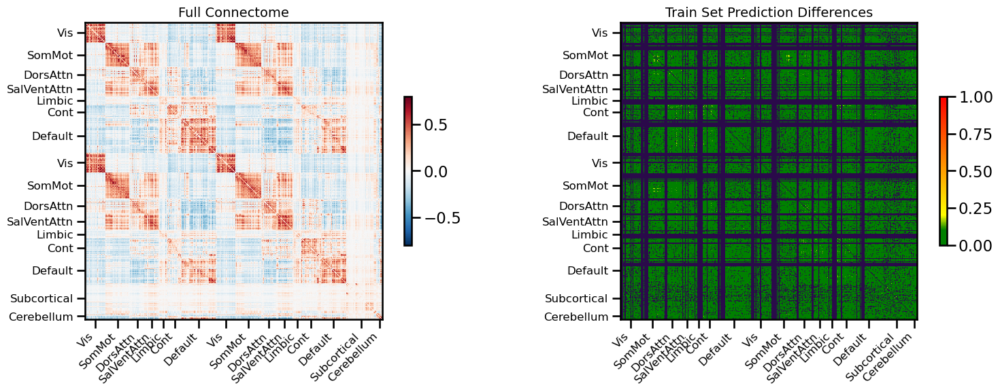

<Figure size 640x480 with 0 Axes>

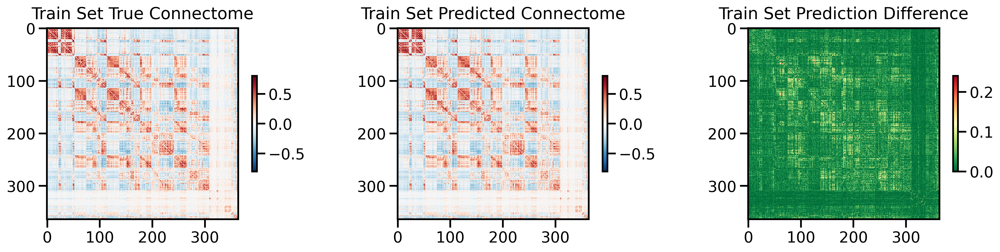

<Figure size 640x480 with 0 Axes>

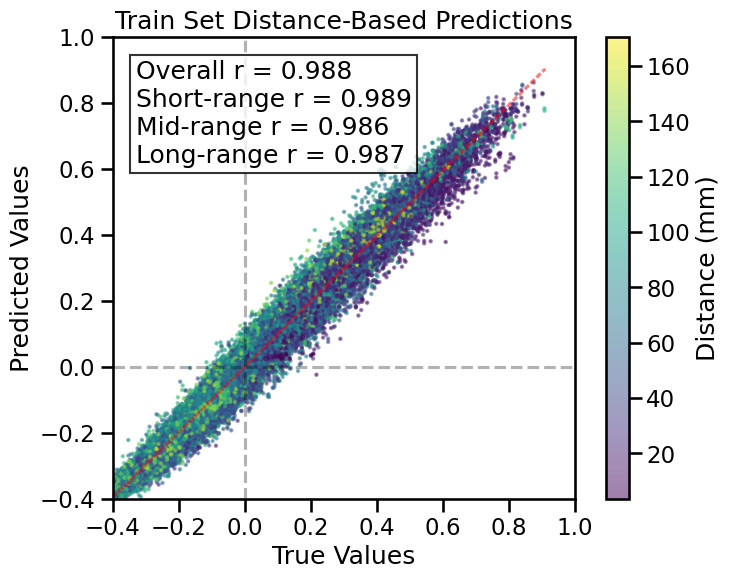

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 91 regions, 8190 connections


<Figure size 640x480 with 0 Axes>

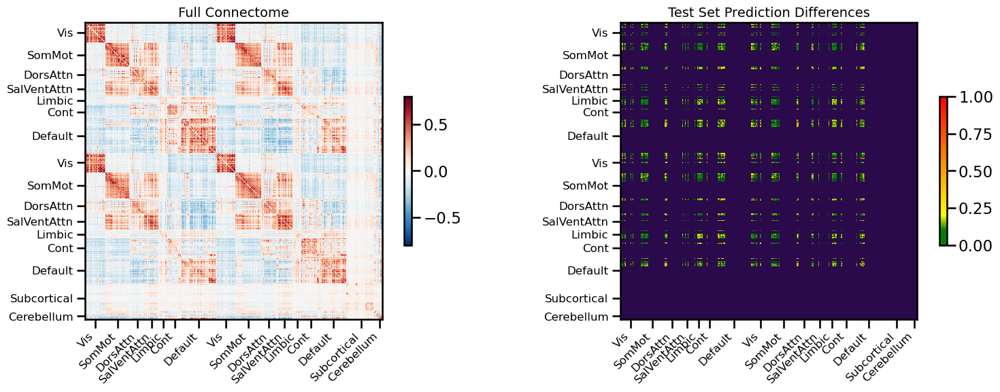

<Figure size 640x480 with 0 Axes>

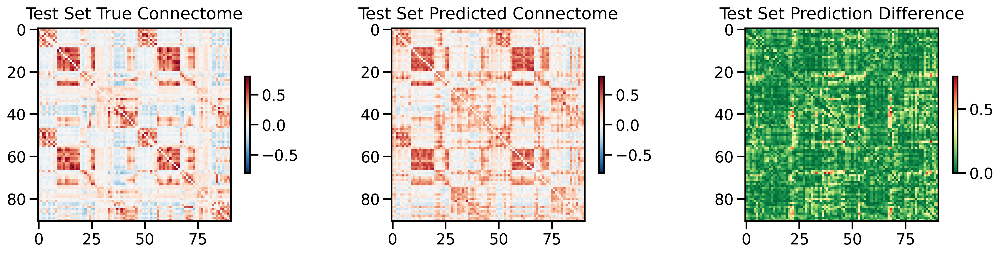

<Figure size 640x480 with 0 Axes>

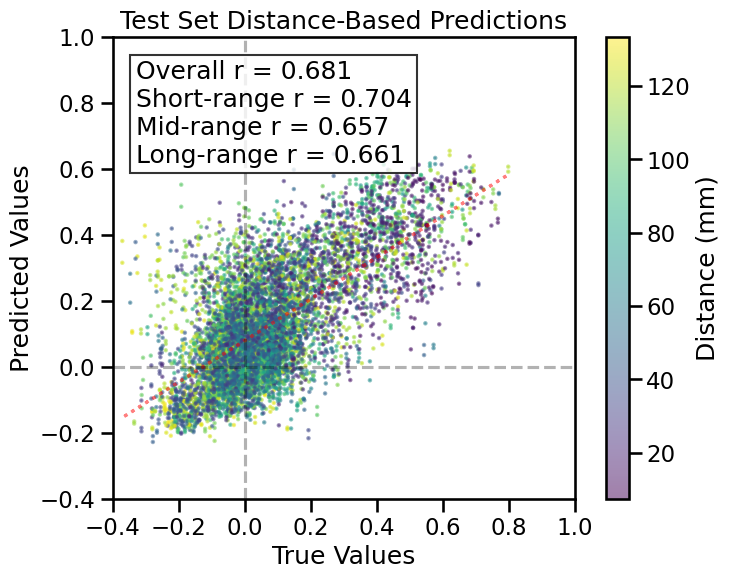

TRAIN METRICS
GLOBAL: mse=0.000847, mae=0.021020, r2=0.9765, pearson_r=0.9883, spearman_r=0.9854, geodesic_distance=12.7221
DISTANCE-BASED: short=0.9890, mid=0.9864, long=0.9866
HEMISPHERIC: left=0.9892, right=0.9897, inter=0.9895
CONNECTION STRENGTH: neg=0.8091, weak=0.9785, pos=0.9230
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9868    0.9889
  Default       0.9921    0.9900
  SalVentAttn    0.9867    0.9879
  Limbic        0.9845    0.9885
  DorsAttn      0.9883    0.9901
  SomMot        0.9912    0.9921
  Vis           0.9964    0.9934
  Subcortical    0.9940    0.9880
  Cerebellum    0.9846    0.9877

TEST METRICS
GLOBAL: mse=0.023302, mae=0.114386, r2=0.3264, pearson_r=0.6811, spearman_r=0.5995, geodesic_distance=9.6289
DISTANCE-BASED: short=0.7038, mid=0.6568, long=0.6609
HEMISPHERIC: left=0.7138, right=0.6524, inter=0.6851
CONNECTION STRENGTH: weak=0.4694, pos=0.3609
NETWORK CORRELATIONS:
  NETWORK      INTRA      INT

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▄▇▆▇▃▃▁▃▁▃▃▂▄▂▁▂▃▁▂▄▂▃▂▂▂▂▁▃▂▂▂▂▂▂▂▂▂▂
train_mse_loss,█▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.06291
test_mse_loss,0.0233
train_mse_loss,0.00154


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ie0u00cz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ie0u00cz
Initialized sweep with ID: ie0u00cz
Testing network: Occipital
Temporal
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: 13obir5f with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.27 GB
Best val loss so far at epoch 1: 0.0344
Best val loss so far at epoch 2: 0.0302
Best val loss so far at epoch 3: 0.0286
Epoch 5/75, Train Loss: 0.0336, Val Loss: 0.0378, Time: 2.68s
Best val loss so far at epoch 10: 0.0285
Epoch 10/75, Train Loss: 0.0157, Val Loss: 0.0285, Time: 2.64s
Best val loss so far at epoch 11: 0.0267
Best val loss so far at epoch 13: 0.0265
Epoch 15/75, Train Loss: 0.0090, Val Loss: 0.0290, Time: 2.79s
Epoch 20/75, Train Loss: 0.0067, Val Loss: 0.0313, Time: 2.76s
Best val loss so far at epoch 21: 0.0263
Best val loss so far at epoch 24: 0.0258
Epoch 25/75, Train Loss: 0.0059, Val Loss: 0.0287, Time: 2.75s
Epoch 30/75, Train Loss: 0.0052, Val Loss: 0.0300, Time: 2.70s
Best val loss so far at epoch 32: 0.0253
Best val loss so far at epoch 33: 0.0239
Epoch 35/75, Train Loss: 0.0049, Val Loss: 0.0408, Time: 2.71s
Epoch 40/75, Train Loss: 0.004

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▃▄▃▃▃█▃▅▃▃▃▃▂▂▁█▆▃▂▃▄▂▂▃▂▂▃▁▂▁▁▁▁▁▂▂▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.0031
fold0_val_loss,0.02444


wandb: Agent Starting Run: 7hqkiu7f with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 75
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15808257
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.32 GB
Best val loss so far at epoch 1: 0.0504
Best val loss so far at epoch 2: 0.0377
Best val loss so far at epoch 3: 0.0354
Best val loss so far at epoch 4: 0.0307
Best val loss so far at epoch 5: 0.0256
Epoch 5/75, Train Loss: 0.0523, Val Loss: 0.0256, Time: 2.89s
Epoch 10/75, Train Loss: 0.0185, Val Loss: 0.0348, Time: 2.87s
Epoch 15/75, Train Loss: 0.0129, Val Loss: 0.0409, Time: 2.85s
Epoch 20/75, Train Loss: 0.0096, Val Loss: 0.0479, Time: 2.98s
Epoch 25/75, Train Loss: 0.0080, Val Loss: 0.0309, Time: 2.91s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.031146
Epoch 30/75, Train Loss: 0.0065, Val Loss: 0.0298, Time: 2.90s
Epoch 35/75, Train Loss: 0.0062, Val Loss: 0.0293, Time: 2.86s
Epoch 40/75, Train Loss: 0.0058, Val Loss: 0.0330, Time: 2.99s
Epoch 45/75, Train Loss: 0.0055, Val Loss: 0.0346, Time: 2.89s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.031987


fold0_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▄▂▁▂▂▃▄▃▄▅▂▅▃▄▂▃▂▃▂▃▂▂▂▂▄▃▃▃▃▃▃▂▃▄▄▃▄▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,54
fold0_train_loss,0.00474
fold0_val_loss,0.03185


wandb: Agent Starting Run: d8xgwpne with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.27 GB
Best val loss so far at epoch 1: 0.0352
Best val loss so far at epoch 2: 0.0308
Best val loss so far at epoch 5: 0.0305
Epoch 5/75, Train Loss: 0.0091, Val Loss: 0.0305, Time: 2.69s
Epoch 10/75, Train Loss: 0.0060, Val Loss: 0.0354, Time: 2.64s
Best val loss so far at epoch 13: 0.0278
Epoch 15/75, Train Loss: 0.0049, Val Loss: 0.0381, Time: 2.75s
Best val loss so far at epoch 19: 0.0256
Epoch 20/75, Train Loss: 0.0041, Val Loss: 0.0431, Time: 2.61s
Epoch 25/75, Train Loss: 0.0038, Val Loss: 0.0328, Time: 2.63s
Epoch 30/75, Train Loss: 0.0034, Val Loss: 0.0373, Time: 2.75s
Epoch 35/75, Train Loss: 0.0032, Val Loss: 0.0350, Time: 2.69s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.035526
Epoch 40/75, Train Loss: 0.0029, Val Loss: 0.0355, Time: 2.70s
Epoch 45/75, Train Loss: 0.0021, Val Loss: 0.0333, Time: 2.64s
Epoch 50/75, Train Loss: 0.0020, Val Loss: 0.0305, Tim

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇███
fold0_train_loss,█▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▅▄▃▄▇▂█▆▇▁▄▃▆▄▃▆▂▃▄▅▇▃▃▃▄▄▃▅▄▄▄▅▄▄▃▄▄▄▄▅
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,68
fold0_train_loss,0.00142
fold0_val_loss,0.03392


wandb: Agent Starting Run: 1p9fhozn with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15808257
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.32 GB
Best val loss so far at epoch 1: 0.0392
Best val loss so far at epoch 2: 0.0377
Best val loss so far at epoch 3: 0.0351
Best val loss so far at epoch 4: 0.0287
Best val loss so far at epoch 5: 0.0249
Epoch 5/100, Train Loss: 0.0527, Val Loss: 0.0249, Time: 3.29s
Epoch 10/100, Train Loss: 0.0179, Val Loss: 0.0296, Time: 3.01s
Epoch 15/100, Train Loss: 0.0121, Val Loss: 0.0319, Time: 3.05s
Best val loss so far at epoch 19: 0.0248
Epoch 20/100, Train Loss: 0.0092, Val Loss: 0.0300, Time: 2.89s
Best val loss so far at epoch 22: 0.0243
Epoch 25/100, Train Loss: 0.0078, Val Loss: 0.0494, Time: 2.94s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.040306
Epoch 30/100, Train Loss: 0.0065, Val Loss: 0.0314, Time: 3.03s
Epoch 35/100, Train Loss: 0.0062, Val Loss: 0.0326, Time: 2.97s
Epoch 40/100, Train Loss: 0.0059, Val Loss: 0.0432, Time: 3.00s
Epoch 45/100, Train Loss: 0.

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇████
fold0_train_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▆▅▂▁▅▂▃▃▄▆▃▃█▁▆▆▃▃▃▄▃▃▇▃▄▄▄▄▄▅▅▅▃▄▅▄▄▅▅▅
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,71
fold0_train_loss,0.00425
fold0_val_loss,0.03551


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 75, 'binarize': False, 'input_dim': 14760, 'batch_size': 512, 'hidden_dims': [256, 128], 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 3812609


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.27 GB
Best val loss so far at epoch 1: 0.2862
Best val loss so far at epoch 2: 0.2491
Best val loss so far at epoch 3: 0.2480


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 4: 0.2201
Best val loss so far at epoch 5: 0.1546
Epoch 5/75, Train Loss: 0.0262, Val Loss: 0.1546, Time: 4.77s
Best val loss so far at epoch 6: 0.1168
Best val loss so far at epoch 9: 0.1036
Best val loss so far at epoch 10: 0.0967
Epoch 10/75, Train Loss: 0.0099, Val Loss: 0.0967, Time: 4.55s
Best val loss so far at epoch 13: 0.0819
Epoch 15/75, Train Loss: 0.0064, Val Loss: 0.1194, Time: 4.73s
Epoch 20/75, Train Loss: 0.0054, Val Loss: 0.1467, Time: 4.71s
Best val loss so far at epoch 25: 0.0816
Epoch 25/75, Train Loss: 0.0048, Val Loss: 0.0816, Time: 4.54s
Best val loss so far at epoch 29: 0.0799
Epoch 30/75, Train Loss: 0.0045, Val Loss: 0.1024, Time: 4.78s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.099172
Epoch 35/75, Train Loss: 0.0036, Val Loss: 0.0821, Time: 4.85s
Epoch 40/75, Train Loss: 0.0034, Val Loss: 0.1012, Time: 4.59s
Epoch 45/75, Train Loss: 0.0033, Val Loss: 0.0839, Time: 4.95s
Epoch 50/75, Train Loss: 0.0031, Val Loss: 0.0944, Time

<Figure size 640x480 with 0 Axes>

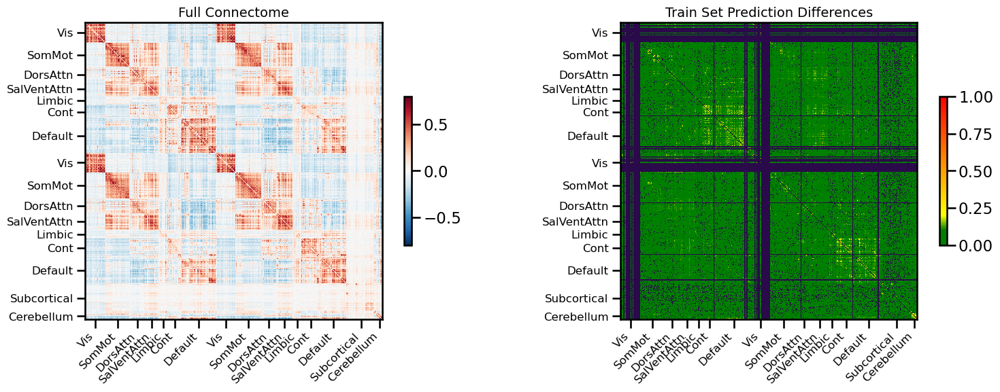

<Figure size 640x480 with 0 Axes>

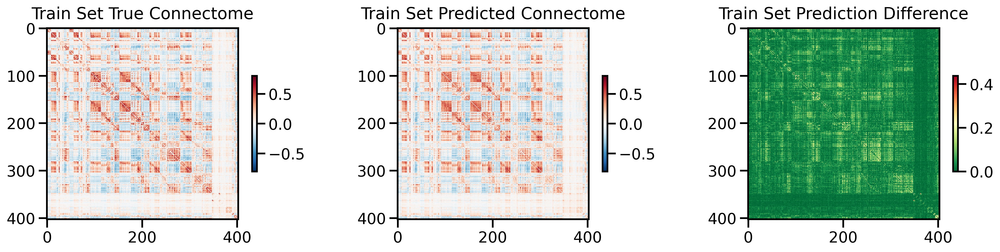

<Figure size 640x480 with 0 Axes>

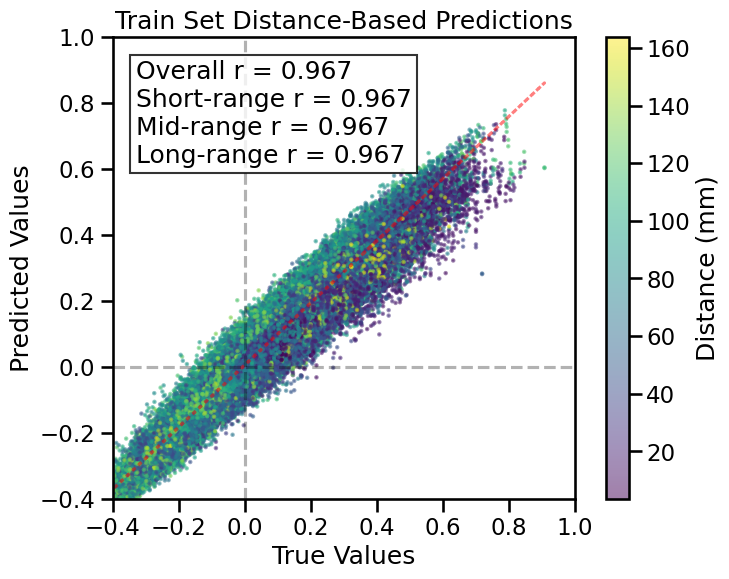

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 52 regions, 2652 connections


<Figure size 640x480 with 0 Axes>

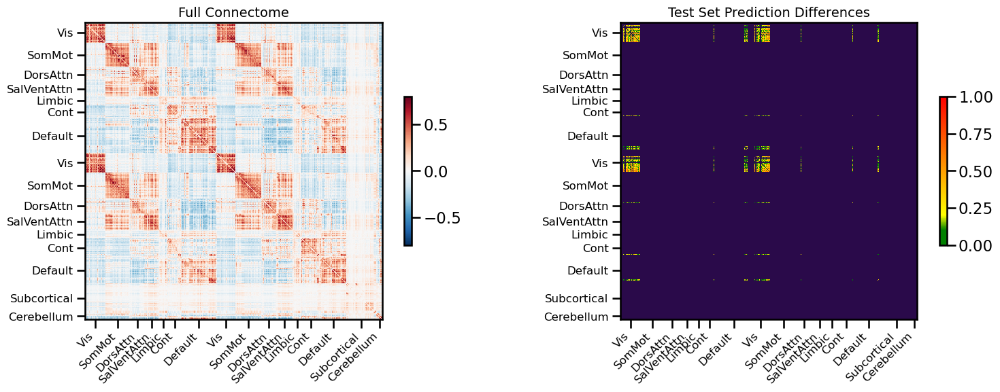

<Figure size 640x480 with 0 Axes>

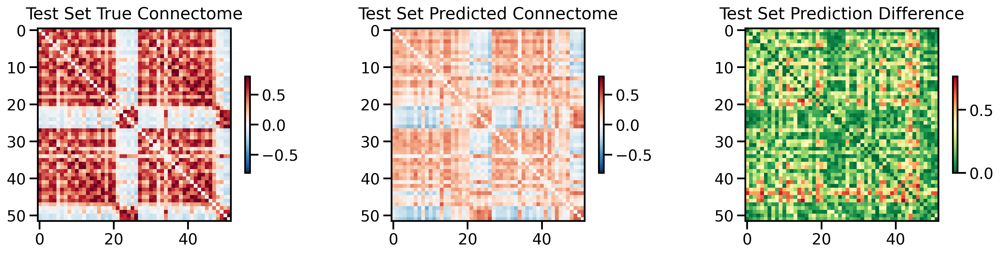

<Figure size 640x480 with 0 Axes>

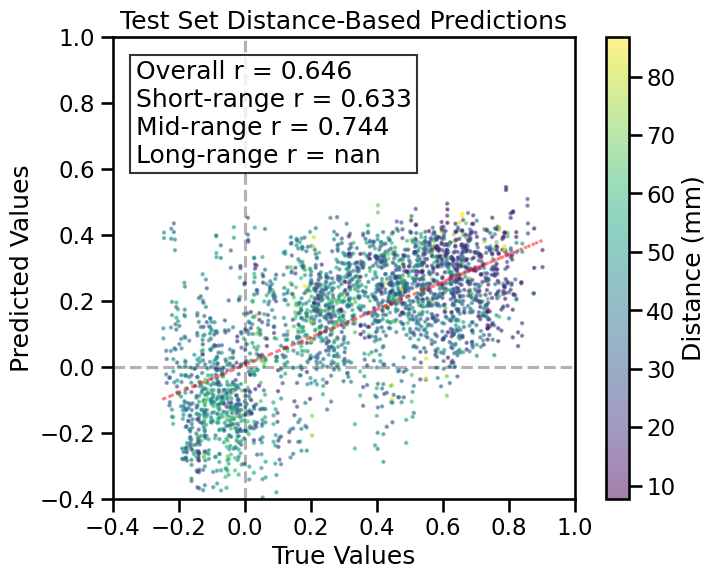

TRAIN METRICS
GLOBAL: mse=0.002130, mae=0.033679, r2=0.9348, pearson_r=0.9672, spearman_r=0.9632, geodesic_distance=18.0171
DISTANCE-BASED: short=0.9666, mid=0.9665, long=0.9670
HEMISPHERIC: left=0.9625, right=0.9681, inter=0.9725
CONNECTION STRENGTH: neg=0.6639, weak=0.9507, pos=0.7175
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9720    0.9725
  Default       0.9724    0.9709
  SalVentAttn    0.9818    0.9742
  Limbic        0.9795    0.9748
  DorsAttn      0.9625    0.9667
  SomMot        0.9490    0.9630
  Vis           0.9511    0.9699
  Subcortical    0.9760    0.9721
  Cerebellum    0.9132    0.9723

TEST METRICS
GLOBAL: mse=0.081121, mae=0.229801, r2=0.0700, pearson_r=0.6460, spearman_r=0.6124, geodesic_distance=9.2838
DISTANCE-BASED: short=0.6331, mid=0.7441
HEMISPHERIC: left=0.6864, right=0.6037, inter=0.6610
CONNECTION STRENGTH: weak=0.5195, pos=0.1867
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  --------

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▄▂▂▃▁▂▃▂▄▃▂▄▁▁▄▂▂▁▁▂▂▁▂▂▂▂▁▂▂▁▂▁▁▂▁▁▁▁
train_mse_loss,█▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02444
test_mse_loss,0.08511
train_mse_loss,0.00266


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 10usw1iw
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/10usw1iw
Initialized sweep with ID: 10usw1iw
Testing network: Parietal
Temporal
Occipital
Frontal
Subcortex


wandb: Agent Starting Run: x7ju4pgw with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 15808257
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.14 GB
Best val loss so far at epoch 1: 0.1305
Best val loss so far at epoch 2: 0.0736
Best val loss so far at epoch 3: 0.0584
Best val loss so far at epoch 4: 0.0504
Best val loss so far at epoch 5: 0.0503
Epoch 5/75, Train Loss: 0.0095, Val Loss: 0.0503, Time: 1.78s
Best val loss so far at epoch 6: 0.0447
Best val loss so far at epoch 7: 0.0431
Best val loss so far at epoch 9: 0.0429
Epoch 10/75, Train Loss: 0.0055, Val Loss: 0.0552, Time: 2.15s
Best val loss so far at epoch 11: 0.0349
Best val loss so far at epoch 15: 0.0345
Epoch 15/75, Train Loss: 0.0046, Val Loss: 0.0345, Time: 1.76s
Epoch 20/75, Train Loss: 0.0037, Val Loss: 0.0445, Time: 2.06s
Best val loss so far at epoch 21: 0.0337
Epoch 25/75, Train Loss: 0.0032, Val Loss: 0.0403, Time: 1.77s
Epoch 30/75, Train Loss: 0.0030, Val Loss: 0.0421, Time: 2.02s
Best val loss so far at epoch 32: 0.0329
Epoch 35/75, Tr

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██
fold0_train_loss,█▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▄▃▃▅▂▂▄▄▂▃▁▂▂▂▂▁▂▁▂▂▃▂▂▁▂▂▁▁▁▂▁▂▂▂▁▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.00129
fold0_val_loss,0.03595


wandb: Agent Starting Run: qm5mcsp8 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.11 GB
Best val loss so far at epoch 1: 0.0418
Best val loss so far at epoch 3: 0.0343
Epoch 5/100, Train Loss: 0.0097, Val Loss: 0.0516, Time: 1.73s
Best val loss so far at epoch 6: 0.0336
Best val loss so far at epoch 9: 0.0318
Epoch 10/100, Train Loss: 0.0060, Val Loss: 0.0460, Time: 2.03s
Epoch 15/100, Train Loss: 0.0047, Val Loss: 0.0401, Time: 1.67s
Epoch 20/100, Train Loss: 0.0038, Val Loss: 0.0348, Time: 1.67s
Best val loss so far at epoch 24: 0.0305
Epoch 25/100, Train Loss: 0.0034, Val Loss: 0.0331, Time: 1.69s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.032788
Epoch 30/100, Train Loss: 0.0033, Val Loss: 0.0328, Time: 1.69s
Epoch 35/100, Train Loss: 0.0023, Val Loss: 0.0323, Time: 1.73s
Epoch 40/100, Train Loss: 0.0023, Val Loss: 0.0363, Time: 1.72s
Epoch 45/100, Train Loss: 0.0023, Val Loss: 0.0331, Time: 1.71s
Epoch 50/100, Train Loss: 0.0022, Val Loss: 0.

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
fold0_train_loss,█▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▅▇▂▅█▂▄▁▆▁▂▂▃▂▂▁▁▂▂▂▂▁▂▂▁▂▁▂▁▁▂▁▁▁▂▂▂▂▂▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,73
fold0_train_loss,0.00161
fold0_val_loss,0.03261


wandb: Agent Starting Run: dh35bt3x with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.11 GB
Best val loss so far at epoch 1: 0.4227
Best val loss so far at epoch 2: 0.0459
Best val loss so far at epoch 5: 0.0458
Epoch 5/75, Train Loss: 0.0096, Val Loss: 0.0458, Time: 1.69s
Best val loss so far at epoch 6: 0.0413
Best val loss so far at epoch 7: 0.0390
Best val loss so far at epoch 8: 0.0380
Epoch 10/75, Train Loss: 0.0064, Val Loss: 0.0431, Time: 1.66s
Best val loss so far at epoch 13: 0.0373
Best val loss so far at epoch 15: 0.0352
Epoch 15/75, Train Loss: 0.0048, Val Loss: 0.0352, Time: 1.69s
Best val loss so far at epoch 19: 0.0327
Epoch 20/75, Train Loss: 0.0040, Val Loss: 0.0381, Time: 1.95s
Epoch 25/75, Train Loss: 0.0034, Val Loss: 0.0353, Time: 1.67s
Epoch 30/75, Train Loss: 0.0031, Val Loss: 0.0336, Time: 2.02s
Epoch 35/75, Train Loss: 0.0030, Val Loss: 0.0356, Time: 1.72s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.033363
Epoch 40/75, Train 

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇█
fold0_train_loss,█▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.00138
fold0_val_loss,0.03263


wandb: Agent Starting Run: ombc4519 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0502
Best val loss so far at epoch 2: 0.0423
Best val loss so far at epoch 3: 0.0415
Best val loss so far at epoch 5: 0.0385
Epoch 5/100, Train Loss: 0.0966, Val Loss: 0.0385, Time: 1.60s
Best val loss so far at epoch 6: 0.0382
Best val loss so far at epoch 7: 0.0356
Best val loss so far at epoch 9: 0.0347
Best val loss so far at epoch 10: 0.0330
Epoch 10/100, Train Loss: 0.0463, Val Loss: 0.0330, Time: 1.95s
Best val loss so far at epoch 13: 0.0315
Best val loss so far at epoch 14: 0.0302
Epoch 15/100, Train Loss: 0.0248, Val Loss: 0.0310, Time: 1.60s
Best val loss so far at epoch 16: 0.0295
Best val loss so far at epoch 18: 0.0284
Epoch 20/100, Train Loss: 0.0155, Val Loss: 0.0295, Time: 1.63s
Epoch 25/100, Train Loss: 0.0126, Val Loss: 0.0302, Time: 1.63s
Epoch 30/100, Train Loss: 0.0111, Val Loss: 0.0306, Time: 1.62s
Epoch 35/

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▇▆▅▅▄▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▅▆▄▃▂▃▃▂▁▁▂▁▁▂▂▂▂▂▅▁▃▃▃▂▂▃▄▄▂▄▆▄▄▂▃▃▅▄
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,67
fold0_train_loss,0.00767
fold0_val_loss,0.0355


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 14760, 'batch_size': 512, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0, 'weight_decay': 0.0001, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 7723777


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.11 GB
Best val loss so far at epoch 1: 0.0825
Best val loss so far at epoch 2: 0.0503
Best val loss so far at epoch 4: 0.0436
Best val loss so far at epoch 5: 0.0392
Epoch 5/100, Train Loss: 0.0080, Val Loss: 0.0392, Time: 3.67s


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 10/100, Train Loss: 0.0053, Val Loss: 0.0428, Time: 3.75s
Best val loss so far at epoch 12: 0.0372
Best val loss so far at epoch 13: 0.0367
Epoch 15/100, Train Loss: 0.0037, Val Loss: 0.0384, Time: 3.51s
Best val loss so far at epoch 17: 0.0365
Best val loss so far at epoch 18: 0.0363
Epoch 20/100, Train Loss: 0.0033, Val Loss: 0.0575, Time: 3.81s
Epoch 25/100, Train Loss: 0.0032, Val Loss: 0.0630, Time: 3.66s
Epoch 30/100, Train Loss: 0.0027, Val Loss: 0.0386, Time: 3.89s
Best val loss so far at epoch 31: 0.0362
Best val loss so far at epoch 33: 0.0350
Epoch 35/100, Train Loss: 0.0025, Val Loss: 0.0426, Time: 3.45s
Best val loss so far at epoch 37: 0.0344
Epoch 40/100, Train Loss: 0.0023, Val Loss: 0.0558, Time: 3.82s
Epoch 45/100, Train Loss: 0.0025, Val Loss: 0.0461, Time: 3.59s
Epoch 50/100, Train Loss: 0.0020, Val Loss: 0.0438, Time: 3.64s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.038872
Epoch 55/100, Train Loss: 0.0015, Val Loss: 0.0357, Time: 3.48s
Epoch 60/100, Trai

<Figure size 640x480 with 0 Axes>

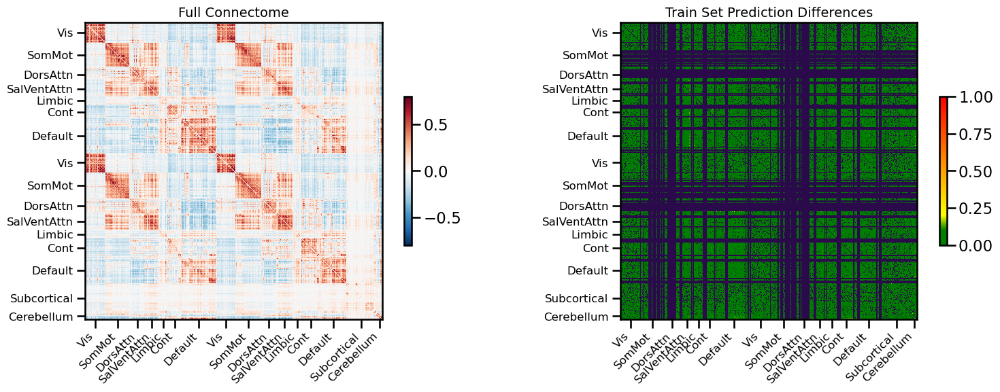

<Figure size 640x480 with 0 Axes>

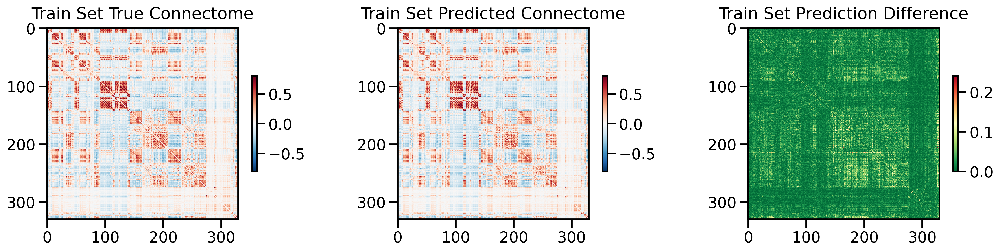

<Figure size 640x480 with 0 Axes>

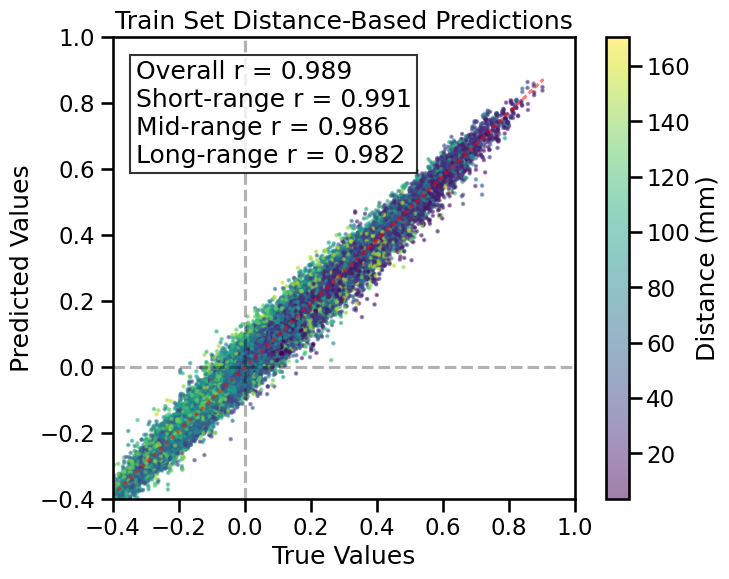

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 125 regions, 15500 connections


<Figure size 640x480 with 0 Axes>

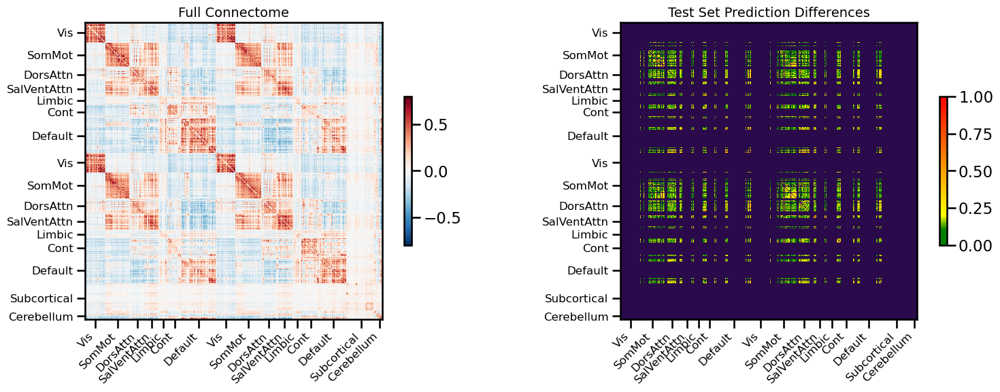

<Figure size 640x480 with 0 Axes>

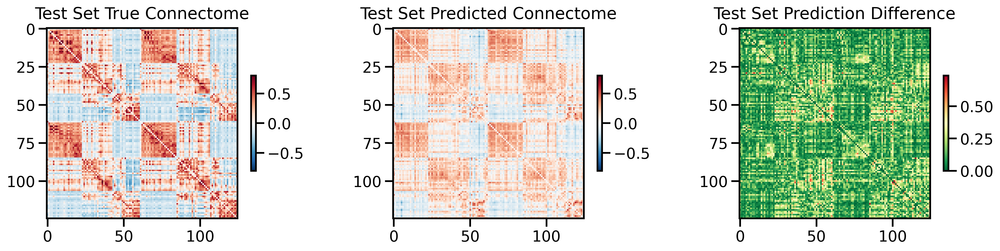

<Figure size 640x480 with 0 Axes>

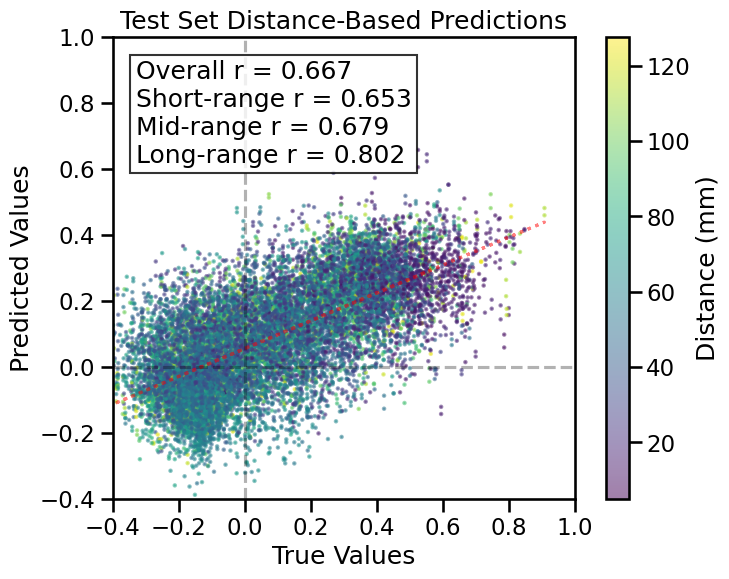

TRAIN METRICS
GLOBAL: mse=0.000701, mae=0.019212, r2=0.9770, pearson_r=0.9886, spearman_r=0.9823, geodesic_distance=13.7932
DISTANCE-BASED: short=0.9906, mid=0.9863, long=0.9821
HEMISPHERIC: left=0.9898, right=0.9908, inter=0.9893
CONNECTION STRENGTH: neg=0.7620, weak=0.9778, pos=0.9559
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9850    0.9887
  Default       0.9884    0.9901
  SalVentAttn    0.9882    0.9900
  Limbic        0.9915    0.9907
  DorsAttn      0.9933    0.9896
  SomMot        0.9886    0.9874
  Vis           0.9897    0.9913
  Subcortical    0.9976    0.9892
  Cerebellum    0.8818    0.9893

TEST METRICS
GLOBAL: mse=0.035441, mae=0.148675, r2=0.4403, pearson_r=0.6673, spearman_r=0.6662, geodesic_distance=12.5307
DISTANCE-BASED: short=0.6532, mid=0.6793, long=0.8018
HEMISPHERIC: left=0.6453, right=0.6902, inter=0.6716
CONNECTION STRENGTH: neg=0.0106, weak=0.5210, pos=0.1803
NETWORK CORRELATIONS:
  NETWORK      I

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▂▂▂▆▂▁▂█▁▁▄▄▆▃▂▁▁▂▃▁▂▁▂▂▁▁▁▁▁▂▁▁▁▂▁▂▁▁▁▁
train_mse_loss,█▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.03261
test_mse_loss,0.03627
train_mse_loss,0.00078


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 524y0bkl
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/524y0bkl
Initialized sweep with ID: 524y0bkl
Testing network: Frontal
Temporal
Occipital
Parietal
Subcortex


wandb: Agent Starting Run: frqm0f1q with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.17 GB
Best val loss so far at epoch 1: 0.0454
Best val loss so far at epoch 4: 0.0441
Epoch 5/100, Train Loss: 0.0083, Val Loss: 0.0447, Time: 1.61s
Best val loss so far at epoch 8: 0.0437
Epoch 10/100, Train Loss: 0.0049, Val Loss: 0.0451, Time: 1.58s
Best val loss so far at epoch 14: 0.0404
Best val loss so far at epoch 15: 0.0398
Epoch 15/100, Train Loss: 0.0036, Val Loss: 0.0398, Time: 1.62s
Epoch 20/100, Train Loss: 0.0031, Val Loss: 0.0484, Time: 1.57s
Epoch 25/100, Train Loss: 0.0026, Val Loss: 0.0497, Time: 1.58s
Epoch 30/100, Train Loss: 0.0024, Val Loss: 0.0579, Time: 1.67s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.040786
Epoch 35/100, Train Loss: 0.0022, Val Loss: 0.0408, Time: 1.60s
Epoch 40/100, Train Loss: 0.0015, Val Loss: 0.0602, Time: 1.85s
Epoch 45/100, Train Loss: 0.0014, Val Loss: 0.0532, Time: 1.65s
Epoch 50/100, Train Loss: 0.0014, Val Loss: 0

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▂█▆▂▂▂▂▂▂▂▁▃▂▂▁▁▄▂▂▄▄▃▂▃▄▄▂▄▃▄▁▃▄▄▃▃▂▃▃▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,64
fold0_train_loss,0.00107
fold0_val_loss,0.05368


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lklxncil with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0574
Best val loss so far at epoch 2: 0.0493
Best val loss so far at epoch 3: 0.0328
Epoch 5/100, Train Loss: 0.0473, Val Loss: 0.0355, Time: 1.59s
Best val loss so far at epoch 7: 0.0299
Best val loss so far at epoch 8: 0.0266
Epoch 10/100, Train Loss: 0.0300, Val Loss: 0.0270, Time: 1.86s
Epoch 15/100, Train Loss: 0.0200, Val Loss: 0.0293, Time: 1.61s
Best val loss so far at epoch 16: 0.0252
Epoch 20/100, Train Loss: 0.0138, Val Loss: 0.0302, Time: 1.54s
Epoch 25/100, Train Loss: 0.0097, Val Loss: 0.0371, Time: 1.59s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.026698
Epoch 30/100, Train Loss: 0.0071, Val Loss: 0.0388, Time: 1.52s
Epoch 35/100, Train Loss: 0.0064, Val Loss: 0.0284, Time: 1.63s
Best val loss so far at epoch 40: 0.0252
Epoch 40/100, Train Loss: 0.0060, Val Loss: 0.0252, Time: 1.59s
Epoch 45/100, Train Loss: 0.0

fold0_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▆▅▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▆▃▃▇▁▂▂▂▁▂▃▄▁▁▄▁▂▂▂▂▁▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▃▃▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,89
fold0_train_loss,0.00362
fold0_val_loss,0.03074


wandb: Agent Starting Run: psmavf5s with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.17 GB
Best val loss so far at epoch 1: 0.0456
Best val loss so far at epoch 2: 0.0335
Epoch 5/75, Train Loss: 0.0433, Val Loss: 0.0353, Time: 1.66s
Best val loss so far at epoch 8: 0.0289
Best val loss so far at epoch 10: 0.0278
Epoch 10/75, Train Loss: 0.0253, Val Loss: 0.0278, Time: 1.63s
Best val loss so far at epoch 12: 0.0274
Epoch 15/75, Train Loss: 0.0160, Val Loss: 0.0303, Time: 1.66s
Best val loss so far at epoch 17: 0.0253
Epoch 20/75, Train Loss: 0.0104, Val Loss: 0.0282, Time: 1.97s
Epoch 25/75, Train Loss: 0.0074, Val Loss: 0.0290, Time: 1.63s
Best val loss so far at epoch 29: 0.0246
Epoch 30/75, Train Loss: 0.0056, Val Loss: 0.0292, Time: 1.66s
Epoch 35/75, Train Loss: 0.0047, Val Loss: 0.0351, Time: 1.66s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.028970
Epoch 40/75, Train Loss: 0.0035, Val Loss: 0.0290, Time: 1.67s
Epoch 45/75, Train Loss: 0.0032, Va

fold0_epoch,▁▁▁▁▁▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇███
fold0_train_loss,█▇▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▄▂▃▂▃▃▃▂▂▁▂▁▂▂▃▁▁▃▃▂▃▂▂▃▂▃▂▃▃▁▂▅▃▃▃▃▃▄
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.00249
fold0_val_loss,0.03512


wandb: Agent Starting Run: xx3bhbjn with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 75
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15808257
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.20 GB
Best val loss so far at epoch 1: 0.0398
Best val loss so far at epoch 3: 0.0393
Best val loss so far at epoch 4: 0.0365
Best val loss so far at epoch 5: 0.0344
Epoch 5/75, Train Loss: 0.0816, Val Loss: 0.0344, Time: 1.70s
Best val loss so far at epoch 6: 0.0325
Best val loss so far at epoch 7: 0.0301
Best val loss so far at epoch 8: 0.0293
Best val loss so far at epoch 10: 0.0275
Epoch 10/75, Train Loss: 0.0336, Val Loss: 0.0275, Time: 1.68s
Best val loss so far at epoch 11: 0.0245
Best val loss so far at epoch 12: 0.0244
Best val loss so far at epoch 15: 0.0235
Epoch 15/75, Train Loss: 0.0183, Val Loss: 0.0235, Time: 1.68s
Best val loss so far at epoch 20: 0.0226
Epoch 20/75, Train Loss: 0.0132, Val Loss: 0.0226, Time: 1.97s
Best val loss so far at epoch 22: 0.0220
Best val loss so far at epoch 24: 0.0220
Epoch 25/75, Train Loss: 0.0101, Val Loss: 0.0258, Time: 1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇██
fold0_train_loss,█▇▆▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▇▆▄▄▄▂▄▁▆▂▁▄▁█▁▄▂▂▄▂▆▂▄▂▇▃▂▄▃▂▃▄▃▃▄▄▅▃▃▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.00409
fold0_val_loss,0.03538


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 14760, 'batch_size': 512, 'hidden_dims': [256, 128], 'dropout_rate': 0.1, 'weight_decay': 1e-05, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 3812609


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0502
Best val loss so far at epoch 2: 0.0495
Best val loss so far at epoch 3: 0.0487


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 4: 0.0405
Epoch 5/100, Train Loss: 0.0370, Val Loss: 0.0472, Time: 3.50s
Epoch 10/100, Train Loss: 0.0185, Val Loss: 0.0489, Time: 3.33s
Best val loss so far at epoch 11: 0.0380
Epoch 15/100, Train Loss: 0.0098, Val Loss: 0.0454, Time: 3.35s
Epoch 20/100, Train Loss: 0.0067, Val Loss: 0.0454, Time: 3.42s
Best val loss so far at epoch 24: 0.0376
Epoch 25/100, Train Loss: 0.0054, Val Loss: 0.0383, Time: 3.74s
Best val loss so far at epoch 28: 0.0362
Epoch 30/100, Train Loss: 0.0047, Val Loss: 0.0560, Time: 3.45s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.039908
Epoch 35/100, Train Loss: 0.0037, Val Loss: 0.0461, Time: 3.39s
Epoch 40/100, Train Loss: 0.0036, Val Loss: 0.0509, Time: 3.48s
Epoch 45/100, Train Loss: 0.0035, Val Loss: 0.0433, Time: 3.50s
Epoch 50/100, Train Loss: 0.0033, Val Loss: 0.0502, Time: 3.39s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.044946
Epoch 55/100, Train Loss: 0.0030, Val Loss: 0.0436, Time: 3.40s
Epoch 60/100, Train Loss

<Figure size 640x480 with 0 Axes>

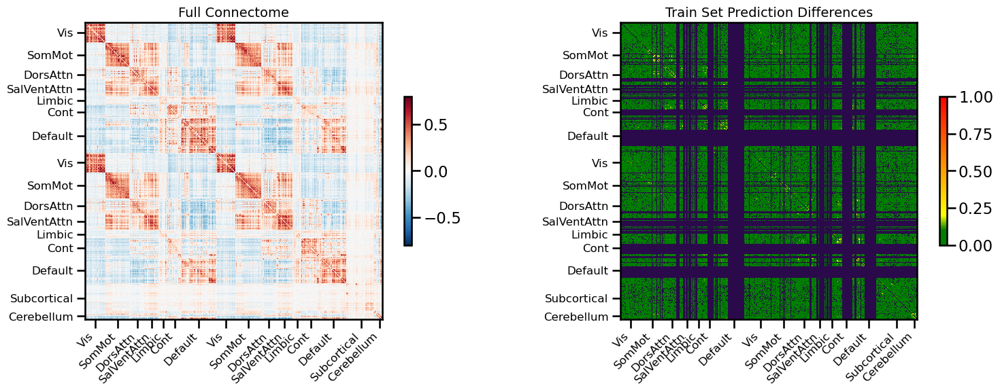

<Figure size 640x480 with 0 Axes>

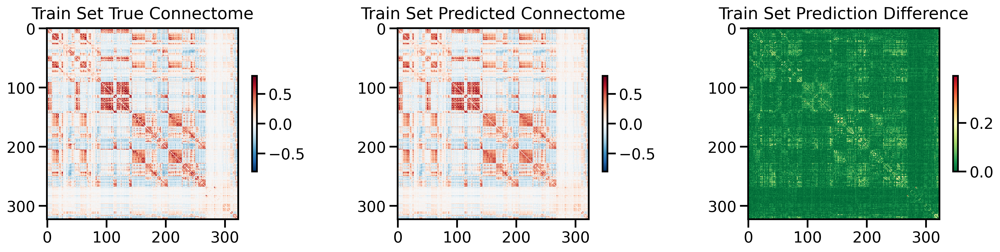

<Figure size 640x480 with 0 Axes>

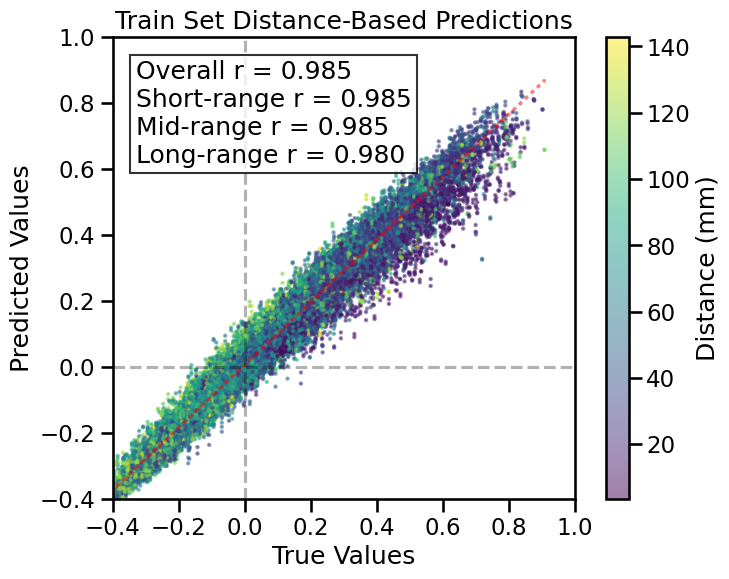

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 132 regions, 17292 connections


<Figure size 640x480 with 0 Axes>

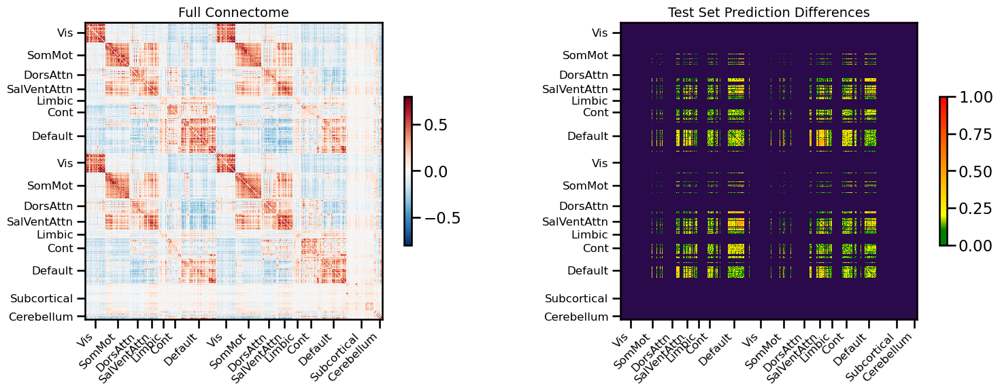

<Figure size 640x480 with 0 Axes>

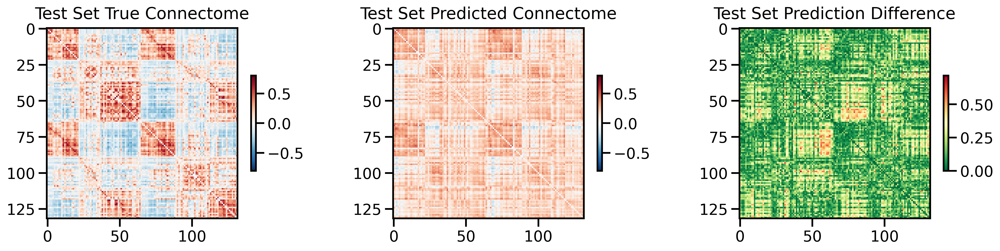

<Figure size 640x480 with 0 Axes>

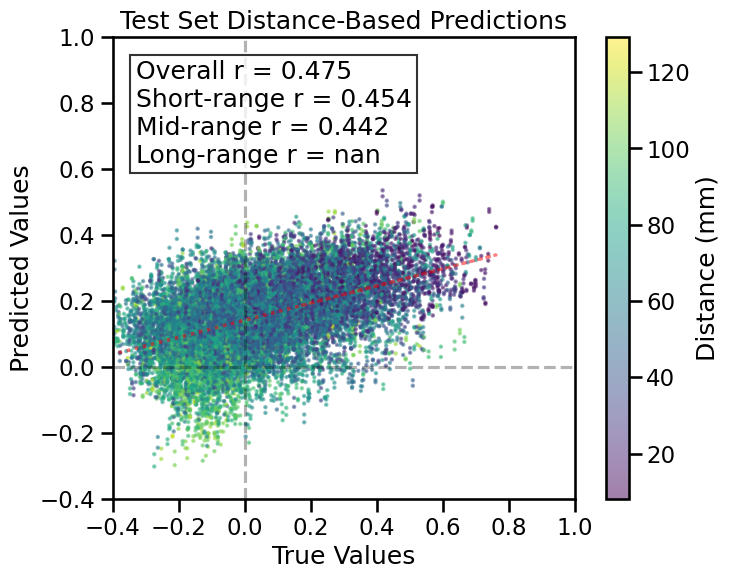

TRAIN METRICS
GLOBAL: mse=0.001097, mae=0.022662, r2=0.9683, pearson_r=0.9847, spearman_r=0.9826, geodesic_distance=14.5490
DISTANCE-BASED: short=0.9846, mid=0.9847, long=0.9804
HEMISPHERIC: left=0.9837, right=0.9861, inter=0.9868
CONNECTION STRENGTH: neg=0.7206, weak=0.9757, pos=0.8611
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9779    0.9820
  Default       0.9808    0.9829
  SalVentAttn    0.9839    0.9838
  Limbic        0.9909    0.9858
  DorsAttn      0.9809    0.9835
  SomMot        0.9874    0.9822
  Vis           0.9809    0.9857
  Subcortical    0.9943    0.9835
  Cerebellum    0.9855    0.9854

TEST METRICS
GLOBAL: mse=0.045065, mae=0.172213, r2=0.0054, pearson_r=0.4750, spearman_r=0.4769, geodesic_distance=12.5185
DISTANCE-BASED: short=0.4536, mid=0.4417
HEMISPHERIC: left=0.4910, right=0.5295, inter=0.4530
CONNECTION STRENGTH: neg=-0.1487, weak=0.3872, pos=0.1891
NETWORK CORRELATIONS:
  NETWORK      INTRA      IN

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▄▄▄▃▄▃▃▇█▃▁▂▄▇▁▆▅▂▅▄▅▃▃▃▄▄▃▃▃▂▄▃▃▃▃▄▄▅▃▂
train_mse_loss,█▇▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.03074
test_mse_loss,0.04506
train_mse_loss,0.00266


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: klgj8i6j
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/klgj8i6j
Initialized sweep with ID: klgj8i6j
Testing network: Subcortex
Temporal
Occipital
Parietal
Frontal


wandb: Agent Starting Run: lqslkfj4 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0632
Best val loss so far at epoch 2: 0.0480
Best val loss so far at epoch 3: 0.0409
Best val loss so far at epoch 4: 0.0291
Epoch 5/100, Train Loss: 0.0670, Val Loss: 0.0333, Time: 2.71s
Best val loss so far at epoch 7: 0.0275
Best val loss so far at epoch 8: 0.0252
Epoch 10/100, Train Loss: 0.0212, Val Loss: 0.0255, Time: 2.63s
Best val loss so far at epoch 11: 0.0247
Epoch 15/100, Train Loss: 0.0147, Val Loss: 0.0254, Time: 2.71s
Epoch 20/100, Train Loss: 0.0120, Val Loss: 0.0289, Time: 2.66s
Epoch 25/100, Train Loss: 0.0109, Val Loss: 0.0365, Time: 2.89s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.026510
Epoch 30/100, Train Loss: 0.0093, Val Loss: 0.0249, Time: 2.92s
Best val loss so far at epoch 35: 0.0238
Epoch 35/100, Train Loss: 0.0089, Val Loss: 0.0238, Time: 2.64s
Best val loss so far at epoch 39: 0.0236
Epoch 40/100

fold0_epoch,▁▁▁▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▆▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▂▂▁▂▃█▆▄▃▄▂▂▂▂▂▁▂▂▂▃▃▂▂▂▂▂▁▂▂▂▂▂▂▁▂▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,97
fold0_train_loss,0.00731
fold0_val_loss,0.02482


wandb: Agent Starting Run: rkklc8jt with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 125
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0613
Best val loss so far at epoch 2: 0.0369
Best val loss so far at epoch 3: 0.0355
Best val loss so far at epoch 4: 0.0308
Best val loss so far at epoch 5: 0.0275
Epoch 5/125, Train Loss: 0.0525, Val Loss: 0.0275, Time: 2.69s
Best val loss so far at epoch 6: 0.0268
Best val loss so far at epoch 7: 0.0238
Best val loss so far at epoch 9: 0.0230
Epoch 10/125, Train Loss: 0.0187, Val Loss: 0.0334, Time: 2.62s
Epoch 15/125, Train Loss: 0.0135, Val Loss: 0.0273, Time: 2.64s
Epoch 20/125, Train Loss: 0.0114, Val Loss: 0.0276, Time: 2.70s
Epoch 25/125, Train Loss: 0.0103, Val Loss: 0.0384, Time: 2.72s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.028195
Epoch 30/125, Train Loss: 0.0089, Val Loss: 0.0246, Time: 2.98s
Epoch 35/125, Train Loss: 0.0087, Val Loss: 0.0262, Time: 2.62s
Epoch 40/125, Train Loss: 0.0085, Val Loss: 0.0282, Tim

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▃▃▂▂▁▄▁▃█▁▃▃▂▅▂▂▁▁▁▂▁▁▁▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,58
fold0_train_loss,0.00755
fold0_val_loss,0.02475


wandb: Agent Starting Run: jfi0g3tt with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0557
Best val loss so far at epoch 2: 0.0492
Best val loss so far at epoch 3: 0.0323
Epoch 5/100, Train Loss: 0.0399, Val Loss: 0.0326, Time: 2.90s
Best val loss so far at epoch 6: 0.0308
Best val loss so far at epoch 7: 0.0295
Epoch 10/100, Train Loss: 0.0196, Val Loss: 0.0361, Time: 2.63s
Best val loss so far at epoch 12: 0.0235
Epoch 15/100, Train Loss: 0.0106, Val Loss: 0.0329, Time: 2.67s
Best val loss so far at epoch 16: 0.0220
Epoch 20/100, Train Loss: 0.0073, Val Loss: 0.0437, Time: 2.71s
Epoch 25/100, Train Loss: 0.0060, Val Loss: 0.0459, Time: 2.64s
Epoch 30/100, Train Loss: 0.0054, Val Loss: 0.0335, Time: 2.94s
Epoch 35/100, Train Loss: 0.0050, Val Loss: 0.0322, Time: 2.65s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.034326
Epoch 40/100, Train Loss: 0.0041, Val Loss: 0.0257, Time: 2.74s
Epoch 45/100, Train Loss: 0.0

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▇▃▃▂▄▁▂▃▂▅▃▅▂▂▂▄▃▃▂▂▁▁▂▂▃▂▂▂▂▂▂▂▁▂▂▁▂▁▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,65
fold0_train_loss,0.00331
fold0_val_loss,0.02698


wandb: Agent Starting Run: vnnm39l7 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.11 GB
Best val loss so far at epoch 1: 0.0466
Best val loss so far at epoch 2: 0.0368
Best val loss so far at epoch 3: 0.0324
Best val loss so far at epoch 4: 0.0284
Epoch 5/75, Train Loss: 0.0305, Val Loss: 0.0390, Time: 2.98s
Best val loss so far at epoch 6: 0.0278
Best val loss so far at epoch 7: 0.0270
Epoch 10/75, Train Loss: 0.0128, Val Loss: 0.0310, Time: 2.96s
Best val loss so far at epoch 11: 0.0223
Epoch 15/75, Train Loss: 0.0071, Val Loss: 0.0305, Time: 3.05s
Epoch 20/75, Train Loss: 0.0053, Val Loss: 0.0284, Time: 2.68s
Best val loss so far at epoch 23: 0.0218
Epoch 25/75, Train Loss: 0.0045, Val Loss: 0.0289, Time: 2.75s
Best val loss so far at epoch 27: 0.0206
Epoch 30/75, Train Loss: 0.0039, Val Loss: 0.0364, Time: 2.71s
Best val loss so far at epoch 33: 0.0202
Epoch 35/75, Train Loss: 0.0035, Val Loss: 0.0234, Time: 2.69s
Epoch 40/75, Train Loss: 0.0032, 

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▅▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▃▆▂▁▃▁▂▁▁▅▂▂▂▂▄▆▃▆▄▂▂▂▁▂▁▁▁▁▂▁▁▂▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.00165
fold0_val_loss,0.02297


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 75, 'binarize': False, 'input_dim': 14760, 'batch_size': 512, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 7723777


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.11 GB
Best val loss so far at epoch 1: 0.1302
Best val loss so far at epoch 2: 0.0921
Best val loss so far at epoch 3: 0.0451


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/75, Train Loss: 0.0161, Val Loss: 0.0726, Time: 4.84s
Epoch 10/75, Train Loss: 0.0062, Val Loss: 0.1509, Time: 4.85s
Epoch 15/75, Train Loss: 0.0044, Val Loss: 0.3087, Time: 5.06s
Epoch 20/75, Train Loss: 0.0037, Val Loss: 0.2472, Time: 4.91s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.441043
Epoch 25/75, Train Loss: 0.0027, Val Loss: 0.4931, Time: 5.20s
Epoch 30/75, Train Loss: 0.0024, Val Loss: 0.6905, Time: 5.04s
Epoch 35/75, Train Loss: 0.0022, Val Loss: 0.7347, Time: 4.92s
Epoch 40/75, Train Loss: 0.0021, Val Loss: 0.8386, Time: 5.27s
Epoch 45/75, Train Loss: 0.0019, Val Loss: 0.7652, Time: 5.37s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.947963
Epoch 50/75, Train Loss: 0.0017, Val Loss: 1.0244, Time: 5.06s

Early stopping triggered at epoch 53. Restoring best model with Val Loss: 0.0451, Pearson Correlation: 0.1112
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 400 regions, 159600 connections


<Figure size 640x480 with 0 Axes>

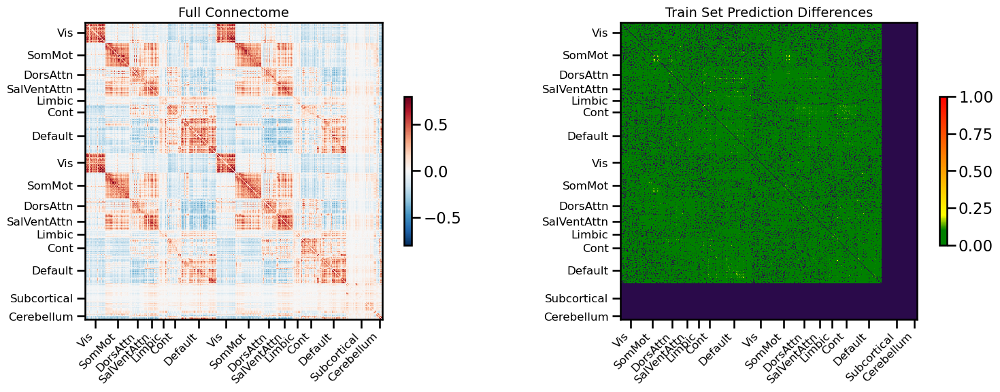

<Figure size 640x480 with 0 Axes>

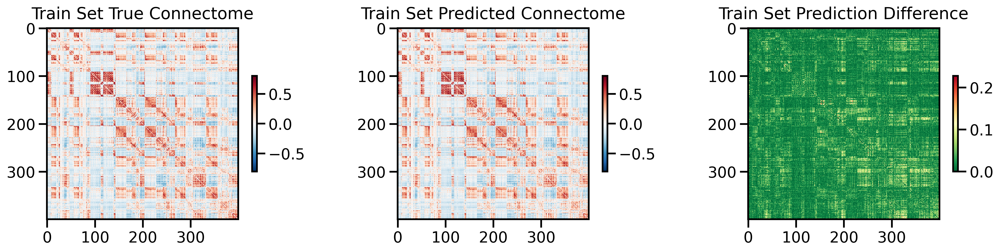

<Figure size 640x480 with 0 Axes>

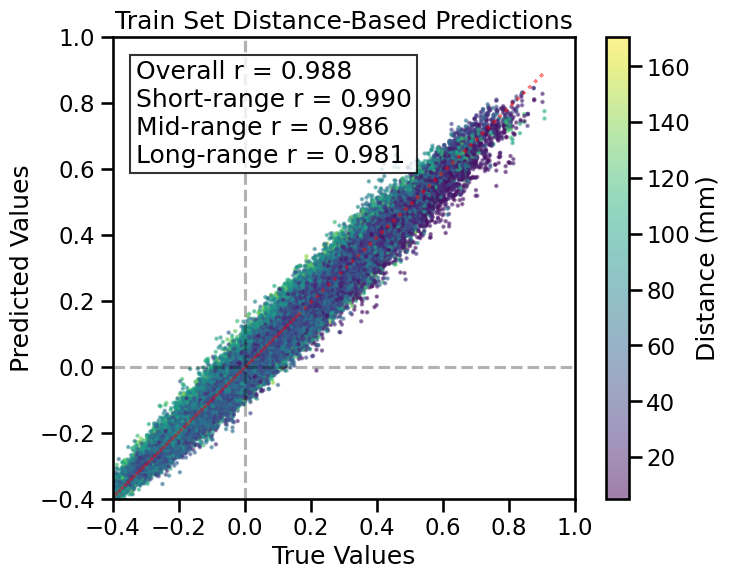

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 55 regions, 2970 connections


<Figure size 640x480 with 0 Axes>

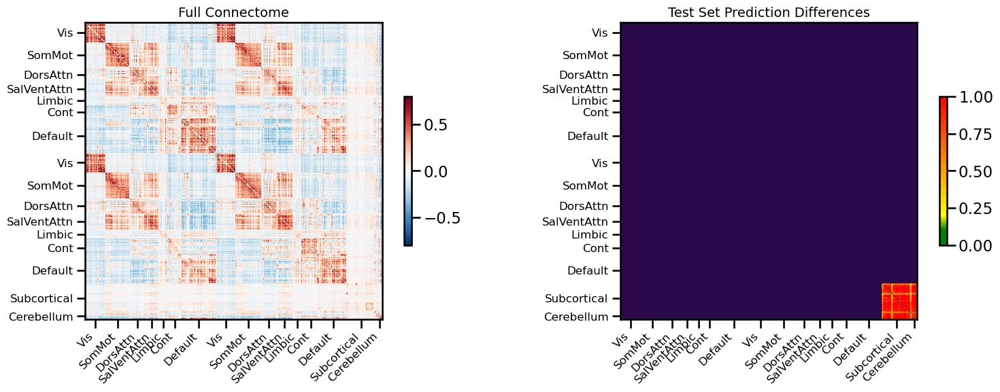

<Figure size 640x480 with 0 Axes>

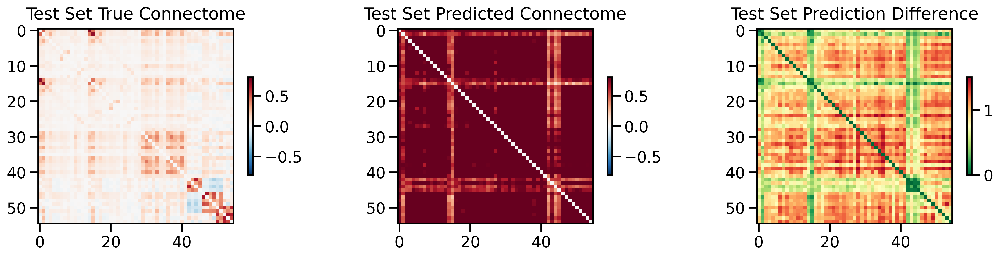

<Figure size 640x480 with 0 Axes>

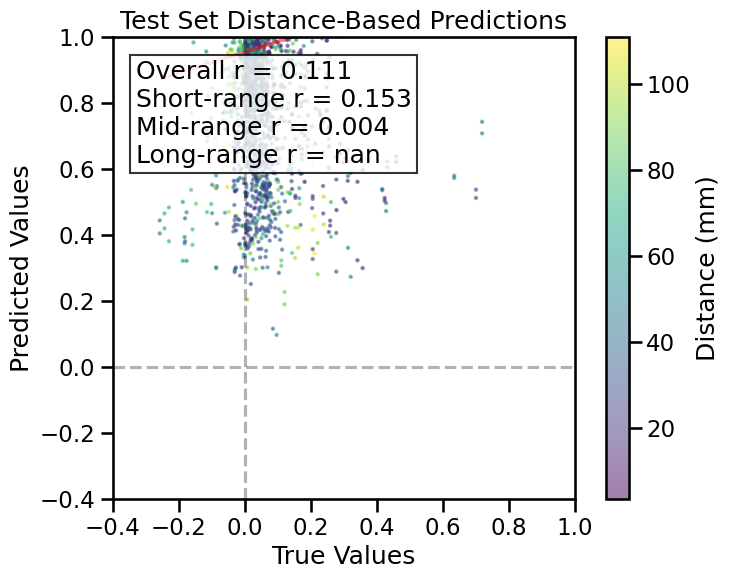

TRAIN METRICS
GLOBAL: mse=0.000985, mae=0.023176, r2=0.9755, pearson_r=0.9877, spearman_r=0.9861, geodesic_distance=10.9467
DISTANCE-BASED: short=0.9897, mid=0.9860, long=0.9813
HEMISPHERIC: left=0.9886, right=0.9908, inter=0.9876
CONNECTION STRENGTH: neg=0.8160, weak=0.9773, pos=0.9187
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9891    0.9894
  Default       0.9891    0.9890
  SalVentAttn    0.9902    0.9900
  Limbic        0.9903    0.9909
  DorsAttn      0.9897    0.9893
  SomMot        0.9864    0.9875
  Vis           0.9880    0.9891

TEST METRICS
GLOBAL: mse=0.912850, mae=0.914896, r2=-100.5252, pearson_r=0.1112, spearman_r=0.1154, geodesic_distance=17.3022
DISTANCE-BASED: short=0.1532, mid=0.0037
HEMISPHERIC: left=0.1735, right=0.1733, inter=0.0384
CONNECTION STRENGTH: weak=0.1112
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Subcortical   -0.2077   -0.2459
  Cerebellum    0.

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▂▁▁▁▁▂▁▂▃▂▃▃▂▃▃▃▄▃▄▄▄▄▆▅▅▅▆▆▅▇▆▇▆▆▆▆▇██▇
train_mse_loss,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02297
test_mse_loss,0.91305
train_mse_loss,0.00166


Final evaluation metrics logged successfully.
CPU Usage: 4.5%
RAM Usage: 4.8%
Available RAM: 958.8G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 5287.00 seconds (88.12 minutes)


0

<Figure size 640x480 with 0 Axes>

In [8]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=False,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none',
              use_folds=[0, 1, 2, 3, 4]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 91, 'Occipital': 52, 'Parietal': 125, 'Frontal': 132, 'Subcortex': 55}
feature_name: transcriptome, processing_type: None
feature_name: euclidean, processing_type: None
features ['transcriptome', 'euclidean']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: walywzo8
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/walywzo8
Initialized sweep with ID: walywzo8
Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: r6jkg5m2 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 7726849
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.1051
Epoch 5/75, Train Loss: 0.0098, Val Loss: 0.1509, Time: 2.60s
Best val loss so far at epoch 9: 0.0993
Epoch 10/75, Train Loss: 0.0052, Val Loss: 0.1030, Time: 2.58s
Best val loss so far at epoch 13: 0.0798
Epoch 15/75, Train Loss: 0.0037, Val Loss: 0.0831, Time: 2.71s
Epoch 20/75, Train Loss: 0.0031, Val Loss: 0.0844, Time: 2.71s
Best val loss so far at epoch 22: 0.0785
Best val loss so far at epoch 24: 0.0771
Best val loss so far at epoch 25: 0.0754
Epoch 25/75, Train Loss: 0.0026, Val Loss: 0.0754, Time: 2.70s
Best val loss so far at epoch 29: 0.0745
Epoch 30/75, Train Loss: 0.0023, Val Loss: 0.0751, Time: 2.60s
Best val loss so far at epoch 31: 0.0720
Epoch 35/75, Train Loss: 0.0019, Val Loss: 0.0721, Time: 2.98s
Best val loss so far at epoch 39: 0.0711
Epoch 40/75, Train Loss: 0.0017, Val Loss: 0.0715, Time: 2.73s
Best va

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▄▇█▇▄▄▂▃▃▃▂▂▂▂▂▂▃▂▂▂▂▂▁▃▂▂▁▂▂▂▃▁▂▁▂▁▁▁▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,74
fold0_train_loss,0.00106
fold0_val_loss,0.07013


wandb: Agent Starting Run: jdb4t568 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 125
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15814401
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.1036
Best val loss so far at epoch 2: 0.0983
Best val loss so far at epoch 4: 0.0924
Best val loss so far at epoch 5: 0.0901
Epoch 5/125, Train Loss: 0.0098, Val Loss: 0.0901, Time: 2.77s
Best val loss so far at epoch 7: 0.0896
Best val loss so far at epoch 8: 0.0851
Best val loss so far at epoch 9: 0.0843
Epoch 10/125, Train Loss: 0.0054, Val Loss: 0.0876, Time: 2.78s
Epoch 15/125, Train Loss: 0.0039, Val Loss: 0.0853, Time: 2.85s
Best val loss so far at epoch 18: 0.0840
Best val loss so far at epoch 19: 0.0803
Best val loss so far at epoch 20: 0.0793
Epoch 20/125, Train Loss: 0.0030, Val Loss: 0.0793, Time: 2.88s
Best val loss so far at epoch 22: 0.0788
Epoch 25/125, Train Loss: 0.0024, Val Loss: 0.0860, Time: 2.85s
Best val loss so far at epoch 26: 0.0781
Best val loss so far at epoch 29: 0.0767
Epoch 30/125, Train Loss: 0.002

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇██
fold0_train_loss,█▇▅▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,██▆▅▅▇▅▄▄▅▄▄▄▄▃▂▃▂▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,124
fold0_train_loss,0.00039
fold0_val_loss,0.06429


wandb: Agent Starting Run: vf9snsfo with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3814145
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.0850
Best val loss so far at epoch 2: 0.0762
Best val loss so far at epoch 4: 0.0688
Epoch 5/75, Train Loss: 0.0103, Val Loss: 0.0732, Time: 2.59s
Best val loss so far at epoch 8: 0.0594
Epoch 10/75, Train Loss: 0.0056, Val Loss: 0.0653, Time: 2.48s
Best val loss so far at epoch 11: 0.0577
Epoch 15/75, Train Loss: 0.0042, Val Loss: 0.0755, Time: 2.61s
Epoch 20/75, Train Loss: 0.0034, Val Loss: 0.0625, Time: 2.55s
Epoch 25/75, Train Loss: 0.0028, Val Loss: 0.0896, Time: 2.63s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.063130
Epoch 30/75, Train Loss: 0.0019, Val Loss: 0.0678, Time: 2.60s
Epoch 35/75, Train Loss: 0.0017, Val Loss: 0.0644, Time: 2.94s
Epoch 40/75, Train Loss: 0.0017, Val Loss: 0.0691, Time: 2.88s
Epoch 45/75, Train Loss: 0.0016, Val Loss: 0.0715, Time: 2.63s
Epoch 50/75, Train Loss: 0.0015, Val Loss: 0.0682, Time

fold0_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▅▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▅▅▃▄▅▁▃▃▁▅▄▅█▄▄▅▂▂▂▂▃▂▄▂▂▃▄▃▆▄▅▄▅▃▄▅▃▄▄▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,60
fold0_train_loss,0.0012
fold0_val_loss,0.06779


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ouu4rjhr with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 100
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15814401
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.1061
Best val loss so far at epoch 3: 0.0968
Epoch 5/100, Train Loss: 0.0310, Val Loss: 0.1057, Time: 2.76s
Best val loss so far at epoch 7: 0.0912
Epoch 10/100, Train Loss: 0.0124, Val Loss: 0.1199, Time: 2.87s
Epoch 15/100, Train Loss: 0.0065, Val Loss: 0.1141, Time: 2.86s
Epoch 20/100, Train Loss: 0.0046, Val Loss: 0.1325, Time: 2.86s
Epoch 25/100, Train Loss: 0.0036, Val Loss: 0.0973, Time: 2.80s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.098561
Best val loss so far at epoch 29: 0.0867
Epoch 30/100, Train Loss: 0.0025, Val Loss: 0.0903, Time: 2.78s
Best val loss so far at epoch 31: 0.0863
Best val loss so far at epoch 32: 0.0827
Best val loss so far at epoch 34: 0.0824
Epoch 35/100, Train Loss: 0.0024, Val Loss: 0.0866, Time: 2.84s
Best val loss so far at epoch 37: 0.0794
Epoch 40/100, Train Loss: 0.0022, Val Loss: 0.082

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█
fold0_train_loss,█▇▄▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▆▄▅▄▆▇▆▅█▅▅▃▃▄▃▃▃▃▂▂▂▂▂▃▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,99
fold0_train_loss,0.00117
fold0_val_loss,0.06266


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 14766, 'batch_size': 512, 'hidden_dims': [1024, 512, 256, 128], 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 15814401


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0312
Best val loss so far at epoch 2: 0.0242
Best val loss so far at epoch 3: 0.0199


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/100, Train Loss: 0.0204, Val Loss: 0.0283, Time: 4.46s
Epoch 10/100, Train Loss: 0.0076, Val Loss: 0.0327, Time: 4.63s
Epoch 15/100, Train Loss: 0.0046, Val Loss: 0.0268, Time: 4.51s
Epoch 20/100, Train Loss: 0.0035, Val Loss: 0.0240, Time: 4.56s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.029411
Epoch 25/100, Train Loss: 0.0024, Val Loss: 0.0283, Time: 4.30s
Epoch 30/100, Train Loss: 0.0021, Val Loss: 0.0248, Time: 4.39s
Epoch 35/100, Train Loss: 0.0021, Val Loss: 0.0249, Time: 4.47s
Epoch 40/100, Train Loss: 0.0019, Val Loss: 0.0234, Time: 4.55s
Epoch 45/100, Train Loss: 0.0018, Val Loss: 0.0271, Time: 4.24s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.024004
Epoch 50/100, Train Loss: 0.0015, Val Loss: 0.0244, Time: 4.77s

Early stopping triggered at epoch 53. Restoring best model with Val Loss: 0.0199, Pearson Correlation: 0.6879
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 364 regions, 132132 connections


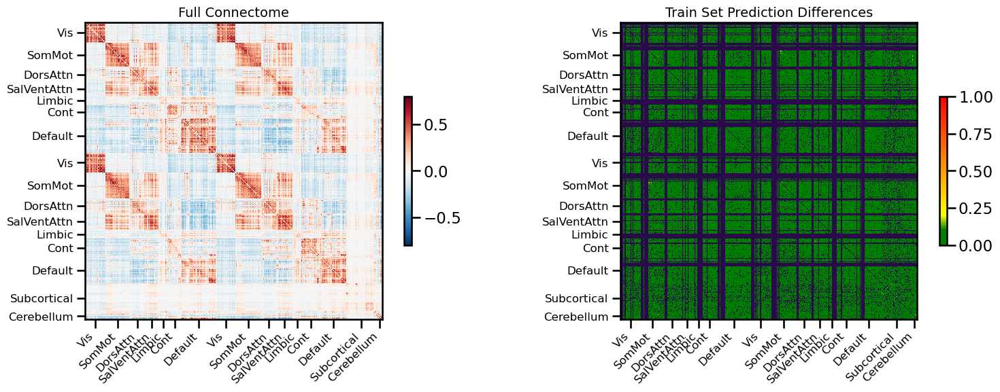

<Figure size 640x480 with 0 Axes>

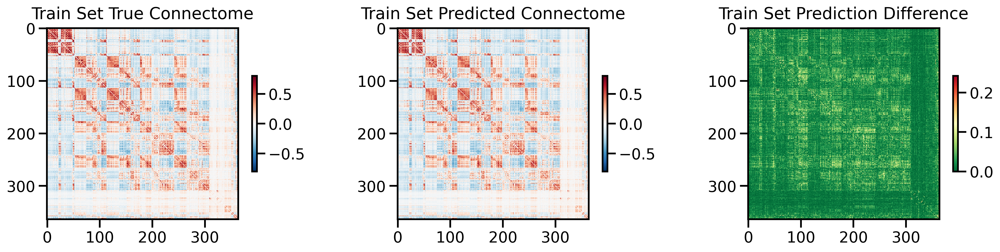

<Figure size 640x480 with 0 Axes>

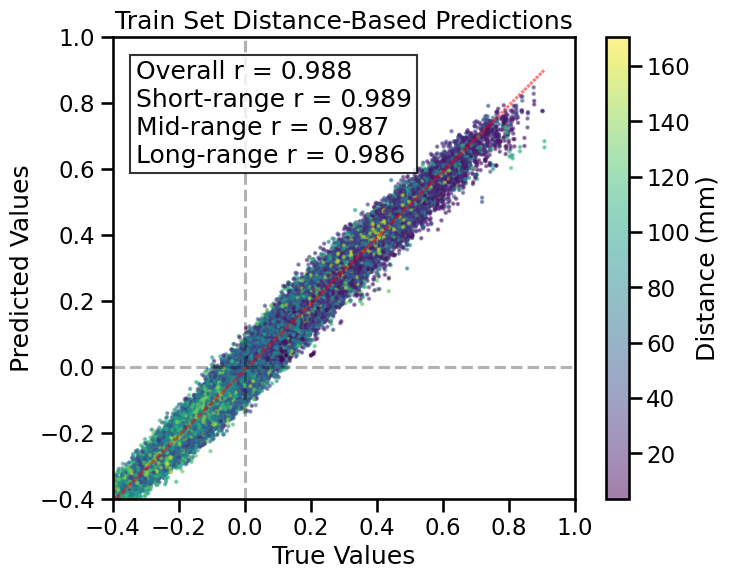

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 91 regions, 8190 connections


<Figure size 640x480 with 0 Axes>

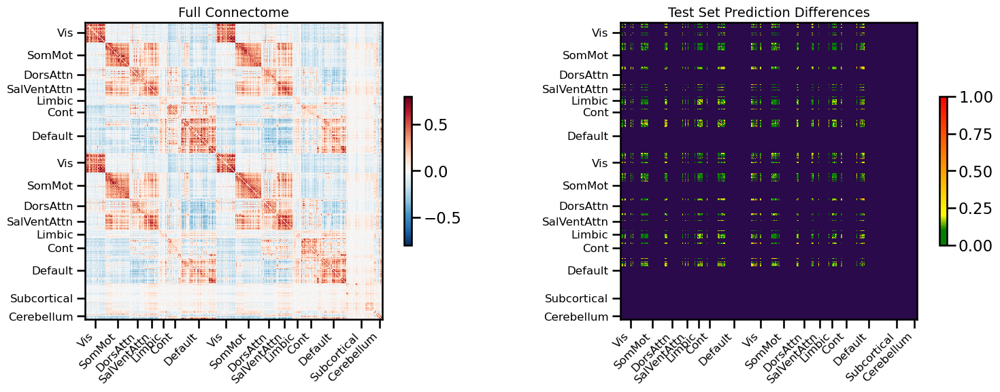

<Figure size 640x480 with 0 Axes>

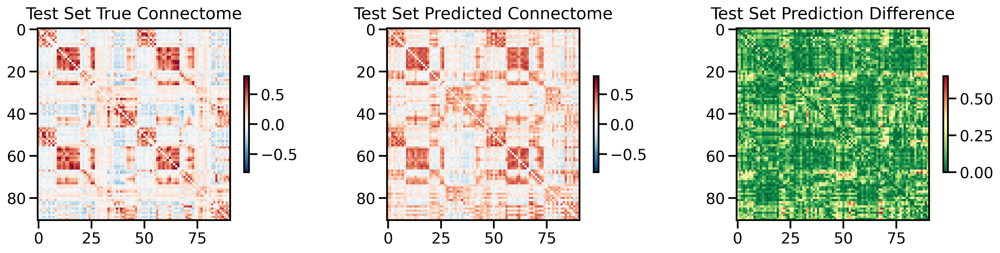

<Figure size 640x480 with 0 Axes>

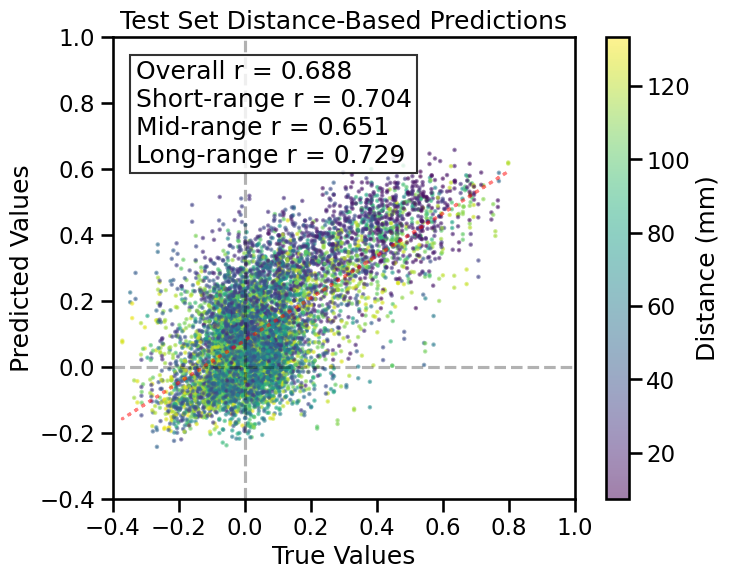

TRAIN METRICS
GLOBAL: mse=0.000922, mae=0.022643, r2=0.9744, pearson_r=0.9885, spearman_r=0.9847, geodesic_distance=12.9911
DISTANCE-BASED: short=0.9888, mid=0.9866, long=0.9863
HEMISPHERIC: left=0.9882, right=0.9885, inter=0.9892
CONNECTION STRENGTH: neg=0.8022, weak=0.9781, pos=0.9365
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9862    0.9886
  Default       0.9904    0.9896
  SalVentAttn    0.9884    0.9891
  Limbic        0.9809    0.9878
  DorsAttn      0.9897    0.9908
  SomMot        0.9892    0.9914
  Vis           0.9957    0.9917
  Subcortical    0.9898    0.9879
  Cerebellum    0.9780    0.9877

TEST METRICS
GLOBAL: mse=0.023131, mae=0.117132, r2=0.3314, pearson_r=0.6879, spearman_r=0.5894, geodesic_distance=8.3913
DISTANCE-BASED: short=0.7040, mid=0.6514, long=0.7287
HEMISPHERIC: left=0.7401, right=0.6773, inter=0.6970
CONNECTION STRENGTH: weak=0.4540, pos=0.3783
NETWORK CORRELATIONS:
  NETWORK      INTRA      INT

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▃▁▂▅▂▃▂▂▃▄▄▂▅█▄▇▄▃▅▅▃▃▃▃▃▃▄▃▄▂▃▃▃▄▃▃▃▃▃▂
train_mse_loss,█▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.06266
test_mse_loss,0.02313
train_mse_loss,0.00148


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 4fi0zebv
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/4fi0zebv
Initialized sweep with ID: 4fi0zebv
Testing network: Occipital
Temporal
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: k930p9ab with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 125
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3814145
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.28 GB
Best val loss so far at epoch 1: 0.0407
Best val loss so far at epoch 2: 0.0363
Best val loss so far at epoch 3: 0.0336
Best val loss so far at epoch 4: 0.0328
Best val loss so far at epoch 5: 0.0286
Epoch 5/125, Train Loss: 0.0457, Val Loss: 0.0286, Time: 2.65s
Best val loss so far at epoch 8: 0.0273
Best val loss so far at epoch 10: 0.0273
Epoch 10/125, Train Loss: 0.0180, Val Loss: 0.0273, Time: 2.69s
Best val loss so far at epoch 15: 0.0248
Epoch 15/125, Train Loss: 0.0126, Val Loss: 0.0248, Time: 2.74s
Epoch 20/125, Train Loss: 0.0106, Val Loss: 0.0273, Time: 2.80s
Epoch 25/125, Train Loss: 0.0094, Val Loss: 0.0267, Time: 2.75s
Epoch 30/125, Train Loss: 0.0085, Val Loss: 0.0293, Time: 2.81s
Epoch 35/125, Train Loss: 0.0079, Val Loss: 0.0258, Time: 2.75s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.025925
Epoch 40/125, Train Loss: 0.0068, Val Loss: 0.0262, T

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇██
fold0_train_loss,█▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▆▃▃▂▃▃▃▁▂▄▂▂▃▂▃▂▃▃▃▂▂▁▂▂▂▂▂▂▁▂▂▂▁▂▂▁▂▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,64
fold0_train_loss,0.00585
fold0_val_loss,0.02552


wandb: Agent Starting Run: p2htd1qx with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 125
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 3814145
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.28 GB
Best val loss so far at epoch 1: 0.0387
Best val loss so far at epoch 2: 0.0322
Epoch 5/125, Train Loss: 0.0109, Val Loss: 0.0323, Time: 2.78s
Best val loss so far at epoch 6: 0.0317
Best val loss so far at epoch 7: 0.0286
Epoch 10/125, Train Loss: 0.0061, Val Loss: 0.0332, Time: 2.69s
Epoch 15/125, Train Loss: 0.0045, Val Loss: 0.0392, Time: 2.64s
Epoch 20/125, Train Loss: 0.0038, Val Loss: 0.0446, Time: 2.68s
Epoch 25/125, Train Loss: 0.0032, Val Loss: 0.0411, Time: 2.76s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.036096
Epoch 30/125, Train Loss: 0.0020, Val Loss: 0.0415, Time: 2.70s
Epoch 35/125, Train Loss: 0.0019, Val Loss: 0.0412, Time: 2.70s
Epoch 40/125, Train Loss: 0.0018, Val Loss: 0.0449, Time: 2.71s
Epoch 45/125, Train Loss: 0.0017, Val Loss: 0.0415, Time: 2.77s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.041113
Epoch 50/125, Train Loss: 0.0016

fold0_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇██
fold0_train_loss,█▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▁▇▃▁▁▆▂▃▃▄▄█▇▅▂▅▆▃▄▆▆▆▃▅█▆▄▇▅▅▆▅█▃█▆▆▇▆
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,56
fold0_train_loss,0.00128
fold0_val_loss,0.04321


wandb: Agent Starting Run: vc00kudh with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 100
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  gc.collect()



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 15814401
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.32 GB
Best val loss so far at epoch 1: 0.0349
Best val loss so far at epoch 2: 0.0295
Best val loss so far at epoch 3: 0.0275
Best val loss so far at epoch 4: 0.0258
Epoch 5/100, Train Loss: 0.0296, Val Loss: 0.0289, Time: 2.93s
Epoch 10/100, Train Loss: 0.0121, Val Loss: 0.0329, Time: 3.04s
Best val loss so far at epoch 12: 0.0250
Epoch 15/100, Train Loss: 0.0064, Val Loss: 0.0286, Time: 3.02s
Best val loss so far at epoch 20: 0.0233
Epoch 20/100, Train Loss: 0.0044, Val Loss: 0.0233, Time: 3.03s
Epoch 25/100, Train Loss: 0.0036, Val Loss: 0.0237, Time: 2.96s
Epoch 30/100, Train Loss: 0.0030, Val Loss: 0.0274, Time: 3.02s
Epoch 35/100, Train Loss: 0.0027, Val Loss: 0.0280, Time: 3.00s
Epoch 40/100, Train Loss: 0.0023, Val Loss: 0.0248, Time: 3.04s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.026615
Epoch 45/100, Train Loss: 0.0018, Val Loss: 0.0265, Time: 3.32s
Epoc

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▅▃▂▂▃▄█▅▁▃▄▂▃▄▃▂▃▆▂▁▃▃▂▂▁▂▂▂▂▂▂▂▂▂▂▃▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,69
fold0_train_loss,0.0013
fold0_val_loss,0.02695


wandb: Agent Starting Run: dqci7b3y with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [1024, 512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  gc.collect()

  warnings.warn(



Number of learnable parameters in MLP: 15814401
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.32 GB
Best val loss so far at epoch 1: 0.0378
Best val loss so far at epoch 2: 0.0314
Best val loss so far at epoch 3: 0.0274
Best val loss so far at epoch 4: 0.0261
Epoch 5/75, Train Loss: 0.0310, Val Loss: 0.0264, Time: 3.09s
Epoch 10/75, Train Loss: 0.0122, Val Loss: 0.0296, Time: 3.07s
Best val loss so far at epoch 15: 0.0243
Epoch 15/75, Train Loss: 0.0066, Val Loss: 0.0243, Time: 2.97s
Epoch 20/75, Train Loss: 0.0046, Val Loss: 0.0508, Time: 2.98s
Best val loss so far at epoch 22: 0.0242
Epoch 25/75, Train Loss: 0.0038, Val Loss: 0.0283, Time: 3.07s
Epoch 30/75, Train Loss: 0.0030, Val Loss: 0.0284, Time: 3.09s
Epoch 35/75, Train Loss: 0.0027, Val Loss: 0.0339, Time: 3.03s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.026060
Epoch 40/75, Train Loss: 0.0020, Val Loss: 0.0269, Time: 2.95s
Epoch 45/75, Train Loss: 0.0019, Val Loss: 0.0254, Time: 3.10s
Epoch 50/75, 

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▇▅▄▄▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▃▁▃▂▂▂▄█▃▁▂▁▁▁▁▂▃▁▂▂▂▁▁▁▂▂▂▂▁▂▁▁▂▁▁▁▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,71
fold0_train_loss,0.00139
fold0_val_loss,0.028


wandb: Sorting runs by +summary_metrics.mean_val_loss
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'epochs': 125, 'binarize': False, 'input_dim': 14766, 'batch_size': 512, 'hidden_dims': [256, 128], 'dropout_rate': 0.3, 'weight_decay': 1e-05, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 3814145


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.28 GB
Best val loss so far at epoch 1: 0.2007
Best val loss so far at epoch 2: 0.1217


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/125, Train Loss: 0.0252, Val Loss: 0.1615, Time: 4.74s
Best val loss so far at epoch 8: 0.1121
Epoch 10/125, Train Loss: 0.0129, Val Loss: 0.1233, Time: 4.86s
Best val loss so far at epoch 11: 0.0975
Best val loss so far at epoch 12: 0.0848
Best val loss so far at epoch 14: 0.0702
Epoch 15/125, Train Loss: 0.0099, Val Loss: 0.0897, Time: 5.01s
Epoch 20/125, Train Loss: 0.0083, Val Loss: 0.0866, Time: 4.63s
Best val loss so far at epoch 22: 0.0690
Epoch 25/125, Train Loss: 0.0075, Val Loss: 0.0831, Time: 4.98s
Best val loss so far at epoch 28: 0.0628
Epoch 30/125, Train Loss: 0.0069, Val Loss: 0.0698, Time: 4.96s
Epoch 35/125, Train Loss: 0.0064, Val Loss: 0.0720, Time: 4.80s
Epoch 40/125, Train Loss: 0.0061, Val Loss: 0.0851, Time: 4.97s
Best val loss so far at epoch 43: 0.0607
Epoch 45/125, Train Loss: 0.0059, Val Loss: 0.0757, Time: 5.01s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.075549
Epoch 50/125, Train Loss: 0.0054, Val Loss: 0.0678, Time: 5.02s
Epoch 55/125, Train 

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}, 
                           {'euclidean': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=False,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none',
              use_folds=[0, 1, 2, 3, 4]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()